<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_DuplicateIMG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [5]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [6]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [7]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [8]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [9]:
%cd '/dataset unzipped'

/dataset unzipped


In [10]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [11]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [12]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
temp_array  = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)

        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        
        #if img.shape[0] != img.shape[1]:
        #    img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))

        X_train.append(image)
image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                  temp_array.append(k)
                temp_array.pop(0)

                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size

                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])
            
            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])

        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #image_test = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)

                width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])
            
            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
#ex_img = cv2.imread('./axial_t1wce_2_class/images/train/00095_200.jpg')
#ex_new_img,extLeft,extRight,extTop,extBot = crop_brain_contour(ex_img, True)

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [13]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [14]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [15]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [16]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [17]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [18]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [19]:
input_ = Input(shape=[180,180, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 180, 180, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 8)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 16)        1168      
                                                                 
 batch_normalization_1 (Batc  (None, 90, 90, 16)       64    

In [20]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [21]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [22]:
callbacks_list = [
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/100
8/8 [==============================] - 1s 84ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


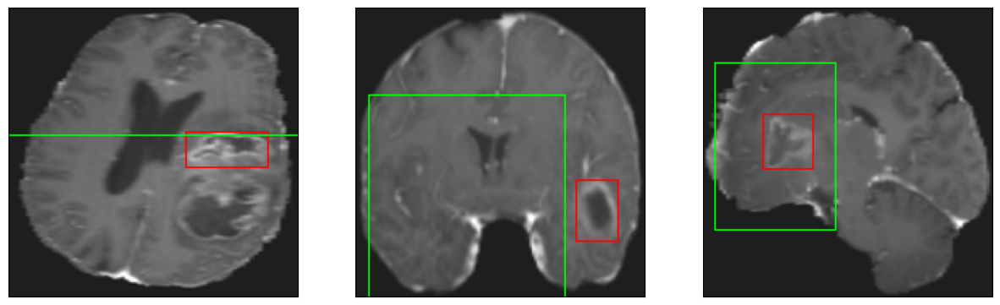

52/52 [==============================] - 32s 255ms/step - loss: 27.7643 - IoU: 0.0560 - val_loss: 94.0354 - val_IoU: 0.0464
Epoch 2/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


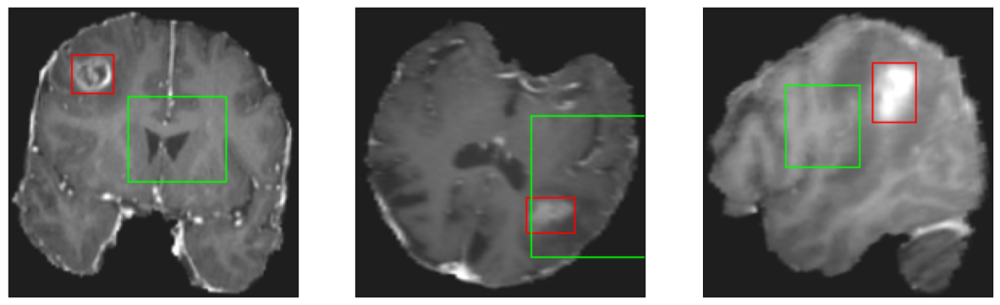

52/52 [==============================] - 10s 191ms/step - loss: 21.8674 - IoU: 0.0708 - val_loss: 37.9153 - val_IoU: 0.0355
Epoch 3/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 37ms/step
4


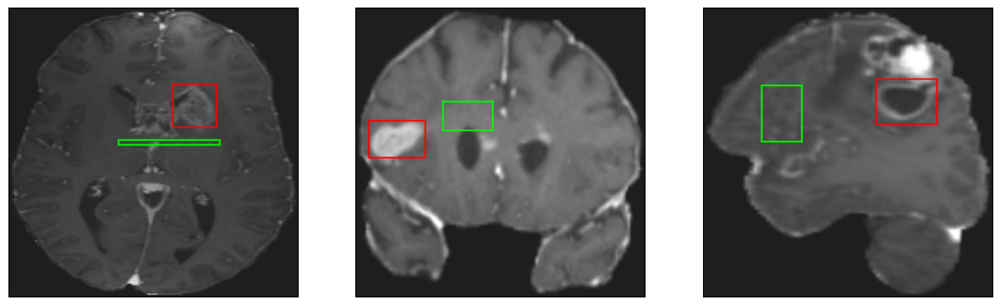

52/52 [==============================] - 10s 199ms/step - loss: 21.6849 - IoU: 0.0724 - val_loss: 30.3929 - val_IoU: 0.0132
Epoch 4/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


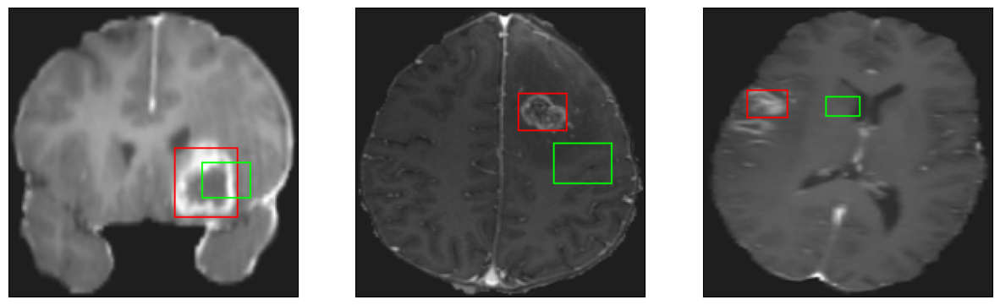

52/52 [==============================] - 11s 203ms/step - loss: 20.3387 - IoU: 0.0943 - val_loss: 29.9145 - val_IoU: 0.0405
Epoch 5/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


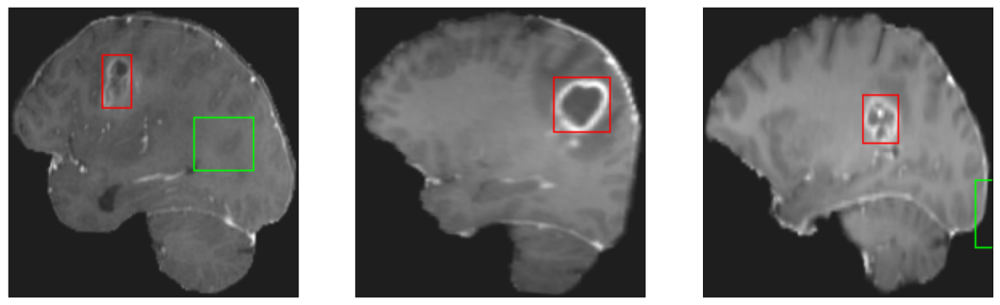

52/52 [==============================] - 11s 206ms/step - loss: 18.9604 - IoU: 0.1173 - val_loss: 25.6010 - val_IoU: 0.0422
Epoch 6/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


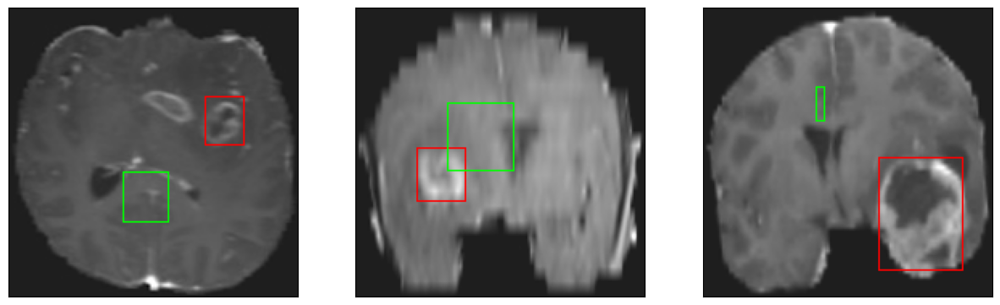

52/52 [==============================] - 11s 208ms/step - loss: 17.6376 - IoU: 0.1504 - val_loss: 18.6820 - val_IoU: 0.1312
Epoch 7/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


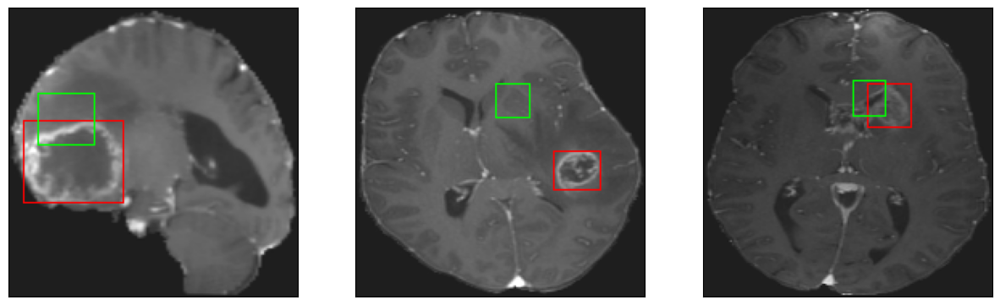

52/52 [==============================] - 10s 196ms/step - loss: 15.4032 - IoU: 0.1835 - val_loss: 17.0429 - val_IoU: 0.1677
Epoch 8/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


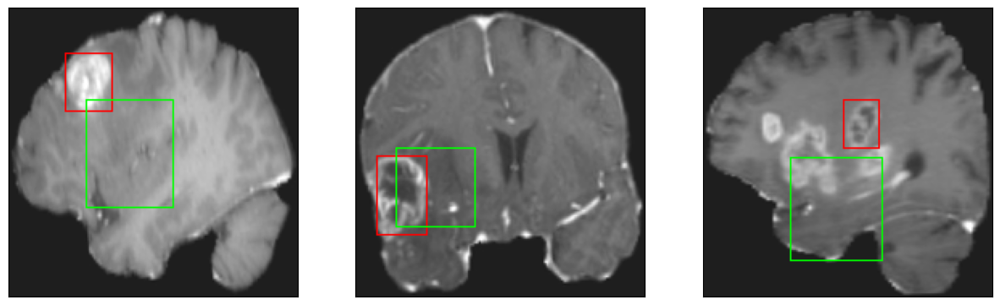

52/52 [==============================] - 10s 199ms/step - loss: 14.4768 - IoU: 0.2156 - val_loss: 21.1801 - val_IoU: 0.1363
Epoch 9/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


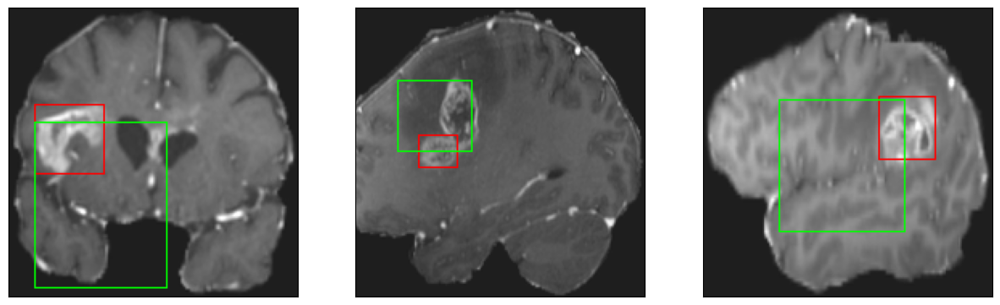

52/52 [==============================] - 10s 202ms/step - loss: 14.3074 - IoU: 0.2220 - val_loss: 30.8863 - val_IoU: 0.1663
Epoch 10/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


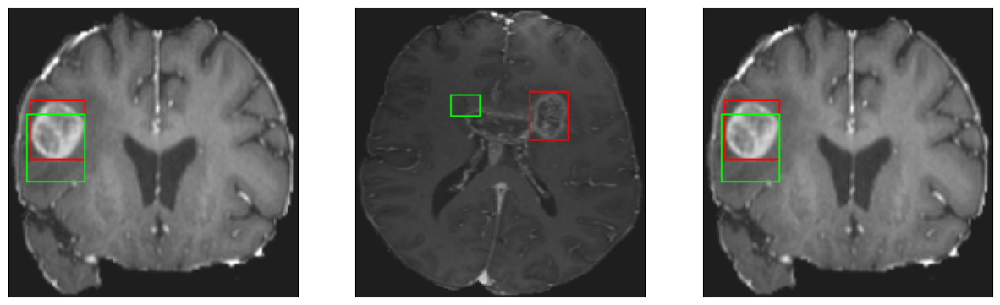

52/52 [==============================] - 11s 203ms/step - loss: 13.8914 - IoU: 0.2265 - val_loss: 12.4456 - val_IoU: 0.2916
Epoch 11/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


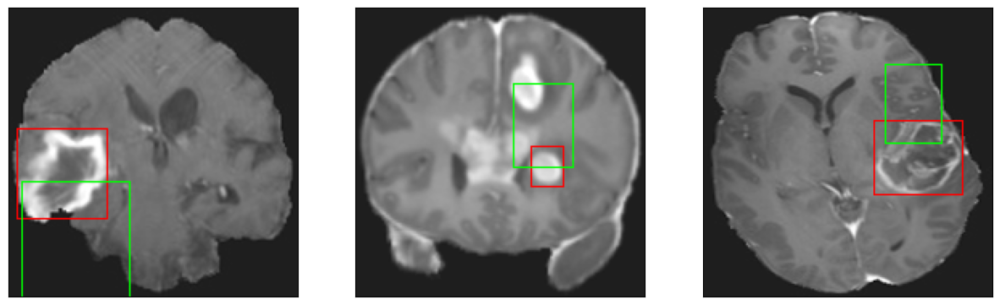

52/52 [==============================] - 11s 208ms/step - loss: 13.0345 - IoU: 0.2505 - val_loss: 15.6986 - val_IoU: 0.1984
Epoch 12/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


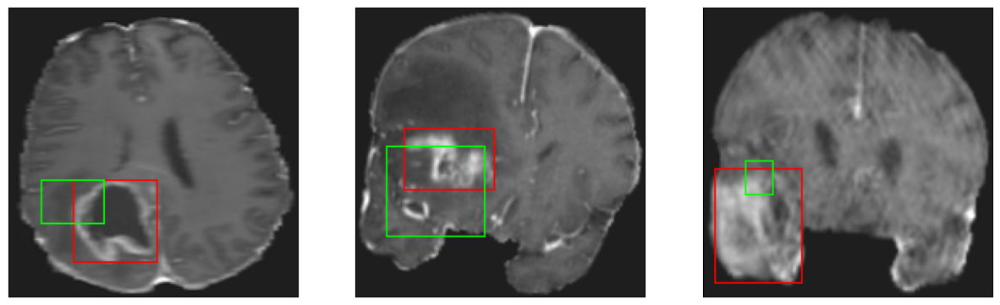

52/52 [==============================] - 11s 204ms/step - loss: 13.1472 - IoU: 0.2521 - val_loss: 14.6339 - val_IoU: 0.1712
Epoch 13/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4


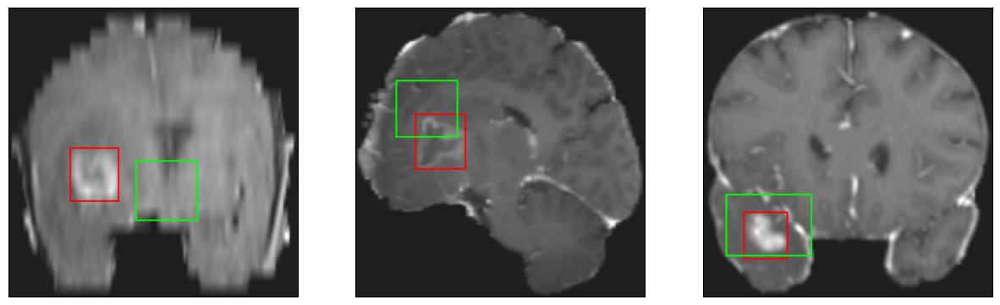

52/52 [==============================] - 11s 210ms/step - loss: 12.4328 - IoU: 0.2644 - val_loss: 12.8989 - val_IoU: 0.2731
Epoch 14/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


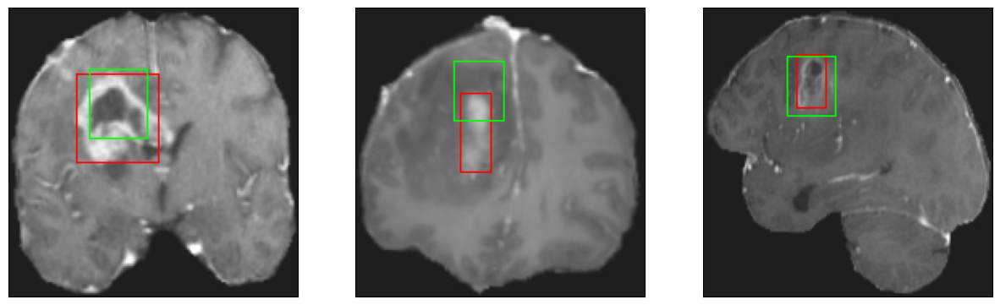

52/52 [==============================] - 11s 203ms/step - loss: 11.8847 - IoU: 0.2754 - val_loss: 12.9794 - val_IoU: 0.2603
Epoch 15/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


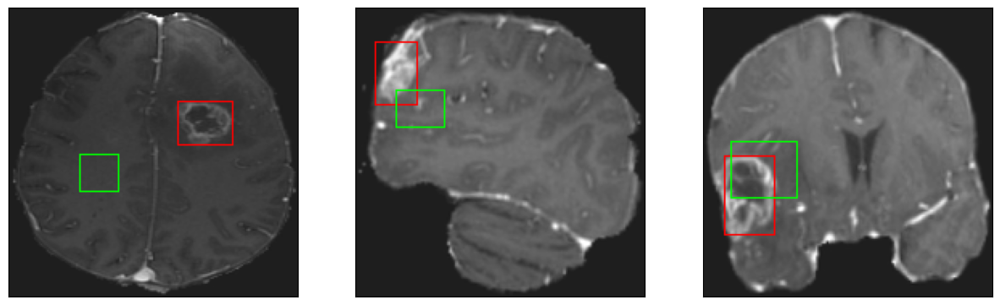

52/52 [==============================] - 11s 208ms/step - loss: 11.6499 - IoU: 0.2776 - val_loss: 12.8013 - val_IoU: 0.2003
Epoch 16/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


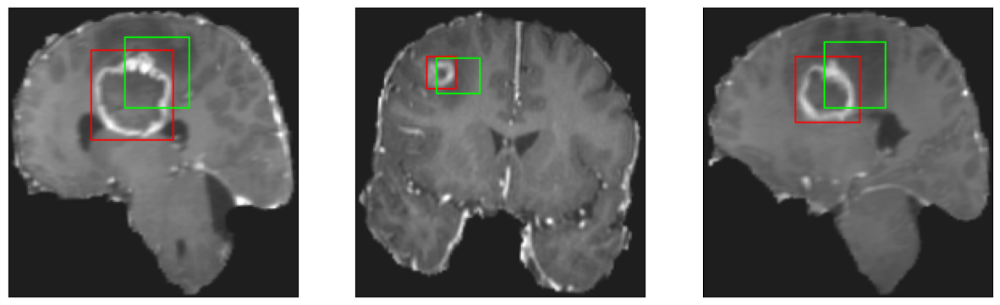

52/52 [==============================] - 11s 210ms/step - loss: 11.1244 - IoU: 0.3013 - val_loss: 15.8070 - val_IoU: 0.1523
Epoch 17/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


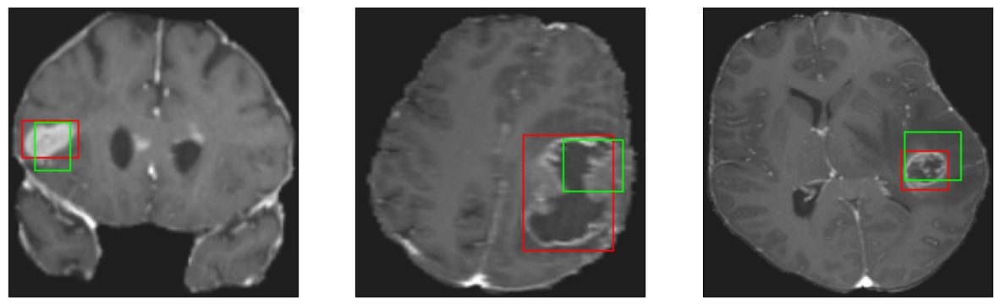

52/52 [==============================] - 11s 212ms/step - loss: 11.4708 - IoU: 0.2854 - val_loss: 13.4295 - val_IoU: 0.2140
Epoch 18/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


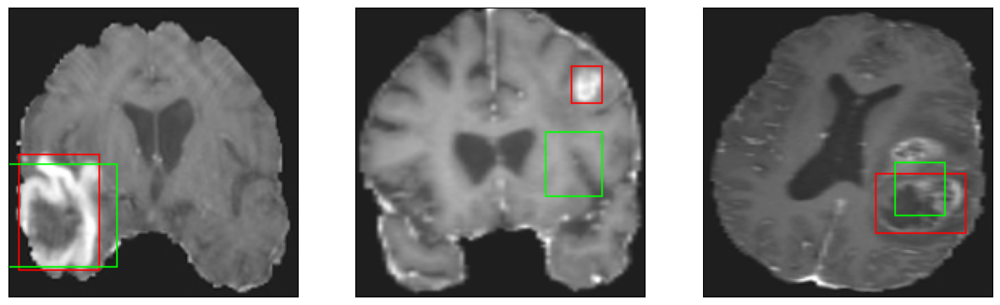

52/52 [==============================] - 11s 205ms/step - loss: 11.0388 - IoU: 0.2953 - val_loss: 10.7826 - val_IoU: 0.3460
Epoch 19/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


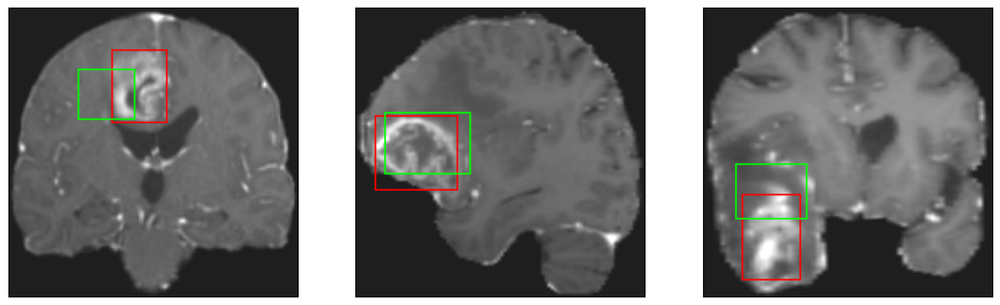

52/52 [==============================] - 11s 211ms/step - loss: 10.4917 - IoU: 0.3189 - val_loss: 10.8467 - val_IoU: 0.3172
Epoch 20/100
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


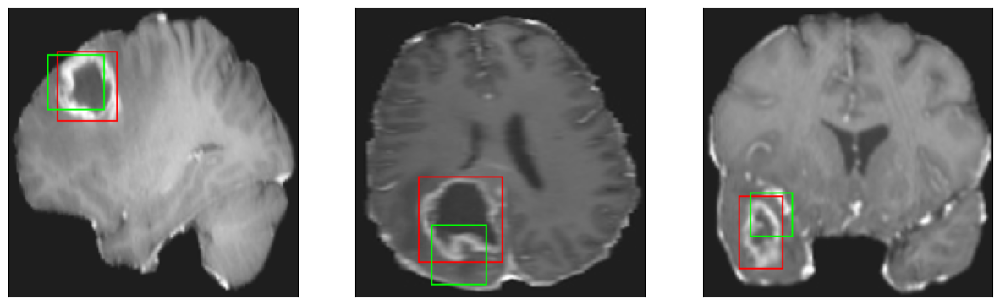

52/52 [==============================] - 11s 205ms/step - loss: 10.2236 - IoU: 0.3288 - val_loss: 10.4046 - val_IoU: 0.3412
Epoch 21/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


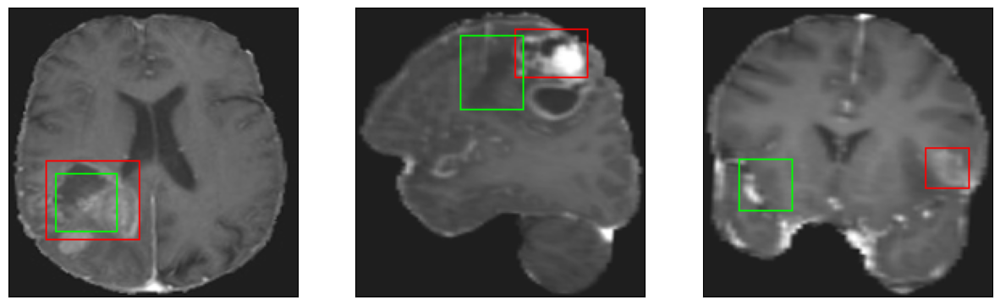

52/52 [==============================] - 11s 208ms/step - loss: 10.4383 - IoU: 0.3193 - val_loss: 10.5612 - val_IoU: 0.3128
Epoch 22/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


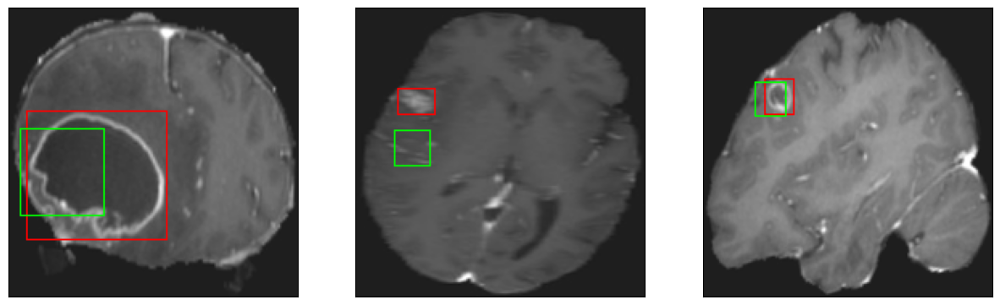

52/52 [==============================] - 11s 205ms/step - loss: 10.0146 - IoU: 0.3365 - val_loss: 10.6295 - val_IoU: 0.3547
Epoch 23/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


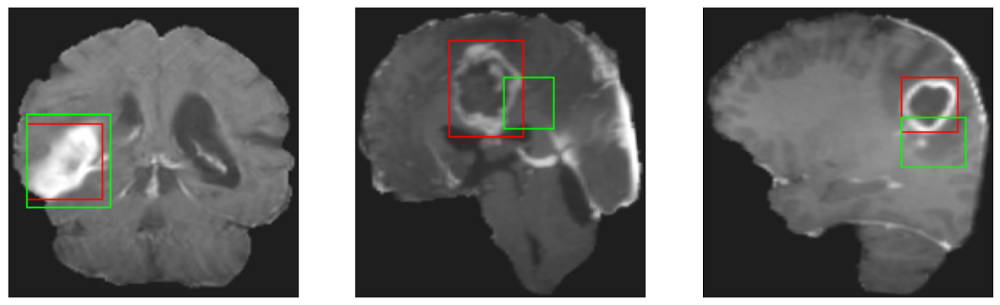

52/52 [==============================] - 11s 204ms/step - loss: 9.3285 - IoU: 0.3564 - val_loss: 10.2261 - val_IoU: 0.3396
Epoch 24/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


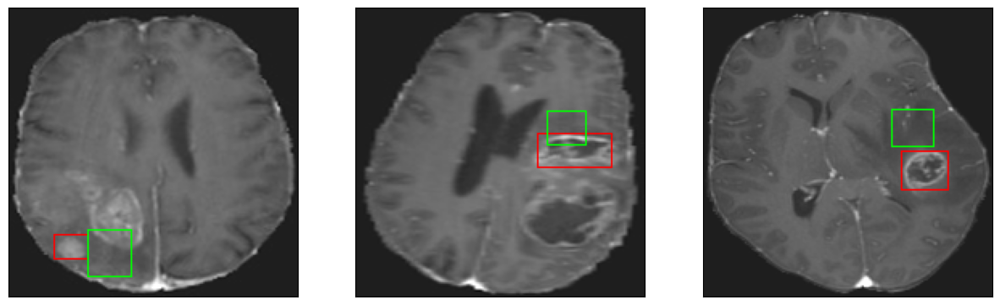

52/52 [==============================] - 11s 206ms/step - loss: 9.9146 - IoU: 0.3372 - val_loss: 12.2191 - val_IoU: 0.2524
Epoch 25/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


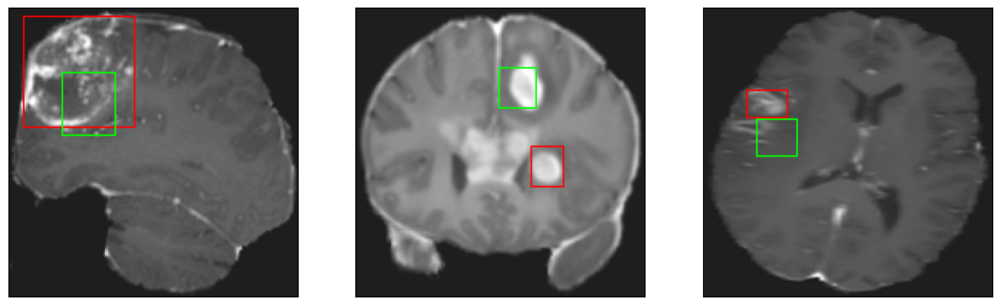

52/52 [==============================] - 11s 210ms/step - loss: 9.5690 - IoU: 0.3537 - val_loss: 11.4496 - val_IoU: 0.3146
Epoch 26/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


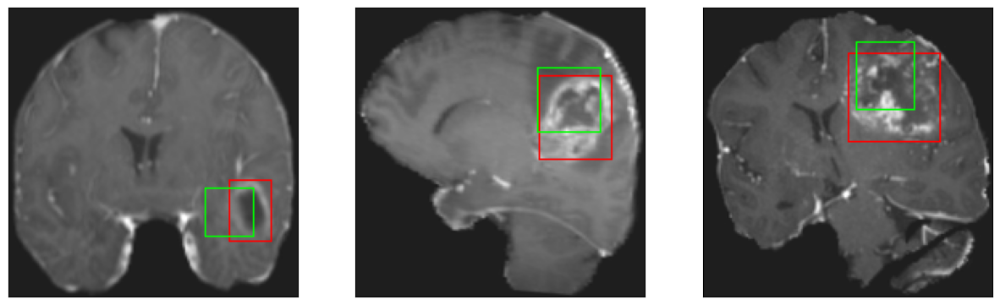

52/52 [==============================] - 11s 207ms/step - loss: 9.1008 - IoU: 0.3598 - val_loss: 8.8549 - val_IoU: 0.3913
Epoch 27/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


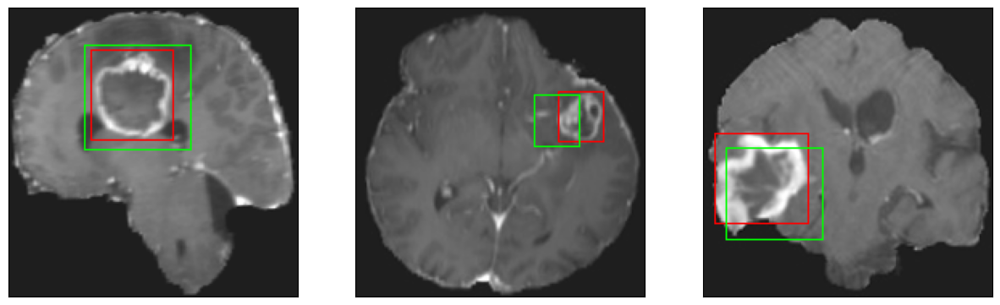

52/52 [==============================] - 11s 210ms/step - loss: 8.8190 - IoU: 0.3839 - val_loss: 8.8191 - val_IoU: 0.4030
Epoch 28/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


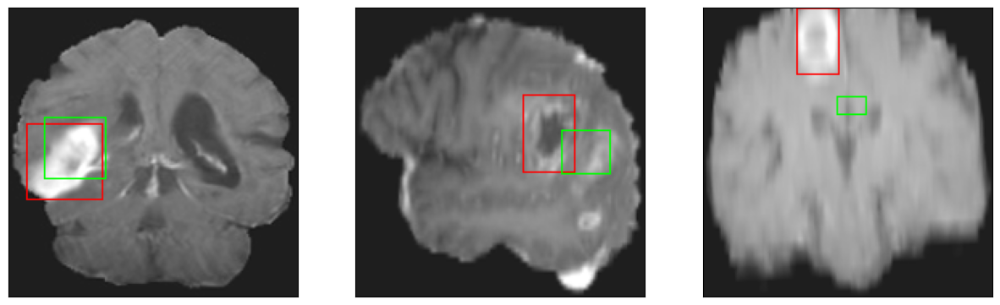

52/52 [==============================] - 11s 210ms/step - loss: 8.8616 - IoU: 0.3700 - val_loss: 10.4732 - val_IoU: 0.3335
Epoch 29/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


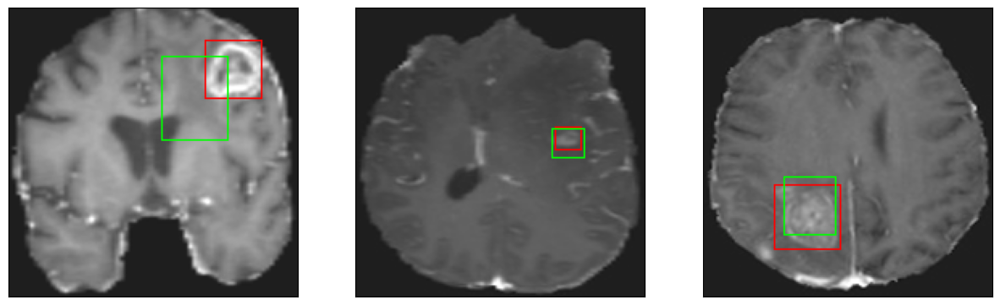

52/52 [==============================] - 11s 208ms/step - loss: 9.0685 - IoU: 0.3694 - val_loss: 12.5476 - val_IoU: 0.3077
Epoch 30/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


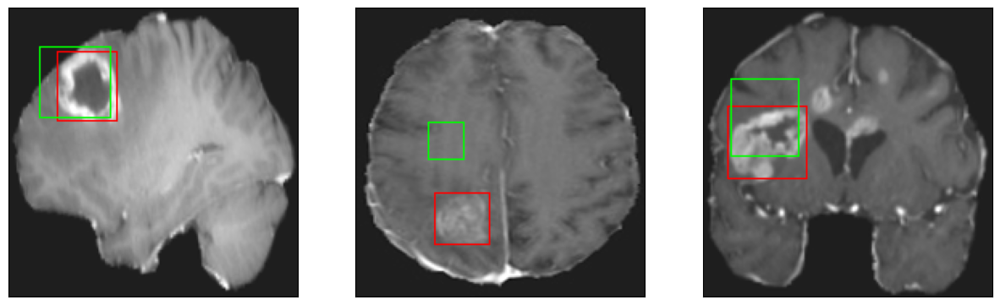

52/52 [==============================] - 11s 210ms/step - loss: 9.2257 - IoU: 0.3540 - val_loss: 11.4324 - val_IoU: 0.2879
Epoch 31/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


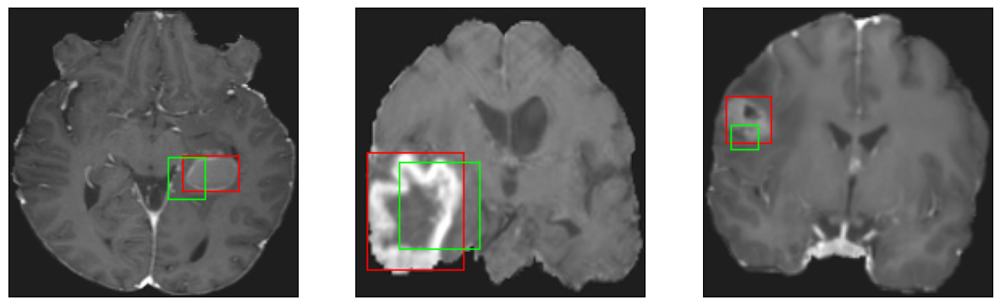

52/52 [==============================] - 11s 205ms/step - loss: 8.9426 - IoU: 0.3703 - val_loss: 9.3379 - val_IoU: 0.3582
Epoch 32/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


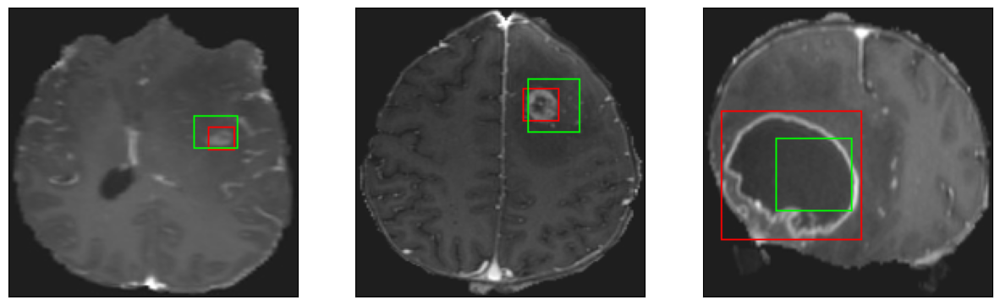

52/52 [==============================] - 11s 211ms/step - loss: 8.8065 - IoU: 0.3667 - val_loss: 10.4340 - val_IoU: 0.3044
Epoch 33/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4


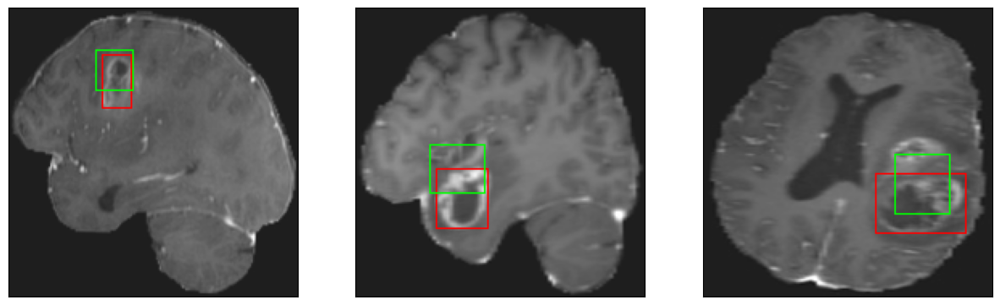

52/52 [==============================] - 11s 204ms/step - loss: 8.4744 - IoU: 0.3822 - val_loss: 7.8992 - val_IoU: 0.4581
Epoch 34/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


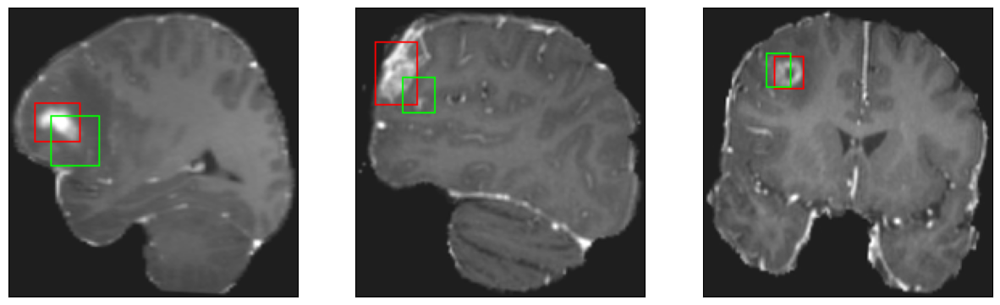

52/52 [==============================] - 11s 206ms/step - loss: 8.0868 - IoU: 0.4077 - val_loss: 8.7256 - val_IoU: 0.3885
Epoch 35/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


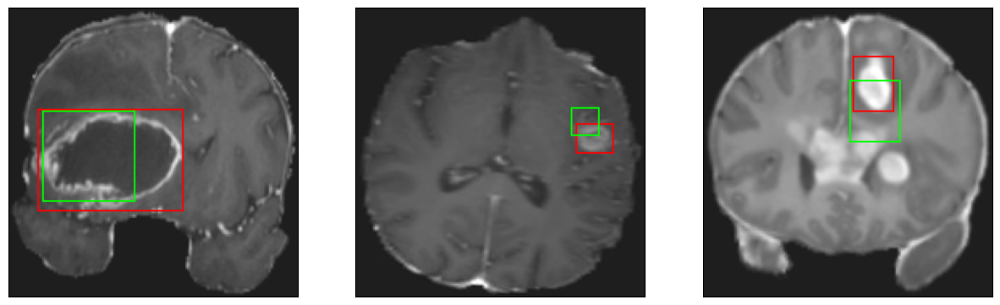

52/52 [==============================] - 11s 204ms/step - loss: 8.4056 - IoU: 0.3889 - val_loss: 9.1963 - val_IoU: 0.3813
Epoch 36/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


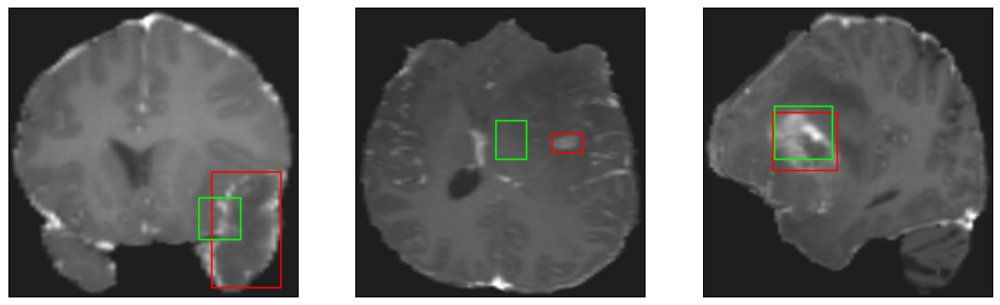

52/52 [==============================] - 11s 209ms/step - loss: 8.3089 - IoU: 0.3932 - val_loss: 8.2792 - val_IoU: 0.4243
Epoch 37/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


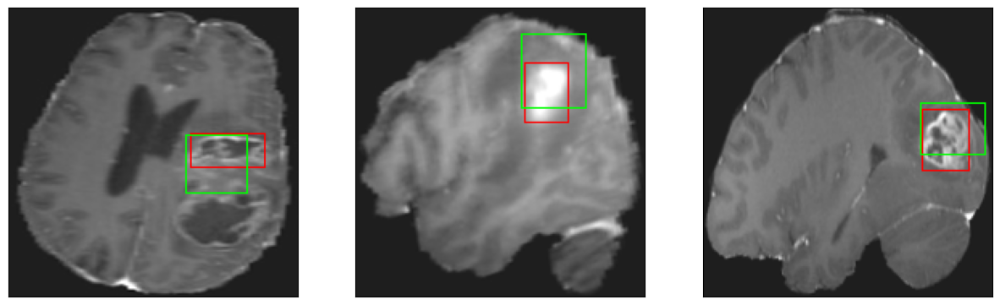

52/52 [==============================] - 11s 208ms/step - loss: 7.8804 - IoU: 0.4120 - val_loss: 7.8854 - val_IoU: 0.4676
Epoch 38/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


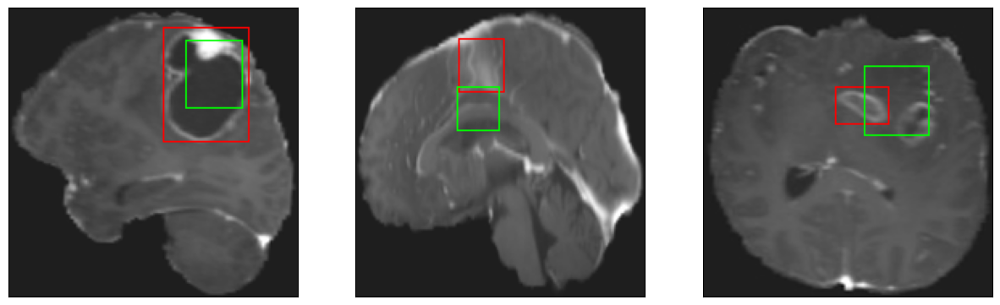

52/52 [==============================] - 11s 204ms/step - loss: 7.9202 - IoU: 0.4118 - val_loss: 9.4353 - val_IoU: 0.3407
Epoch 39/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


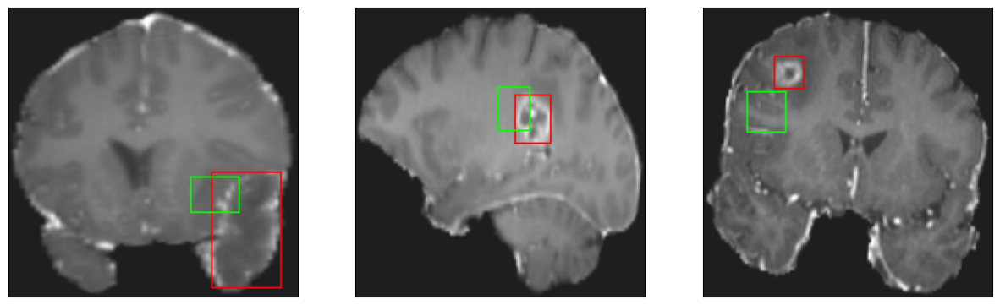

52/52 [==============================] - 11s 217ms/step - loss: 7.8221 - IoU: 0.4148 - val_loss: 9.4592 - val_IoU: 0.3559
Epoch 40/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 42ms/step
4


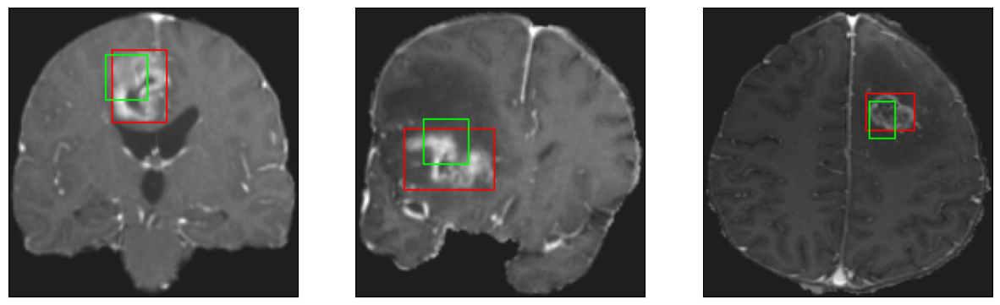

52/52 [==============================] - 11s 209ms/step - loss: 8.0722 - IoU: 0.4092 - val_loss: 11.4419 - val_IoU: 0.2694
Epoch 41/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


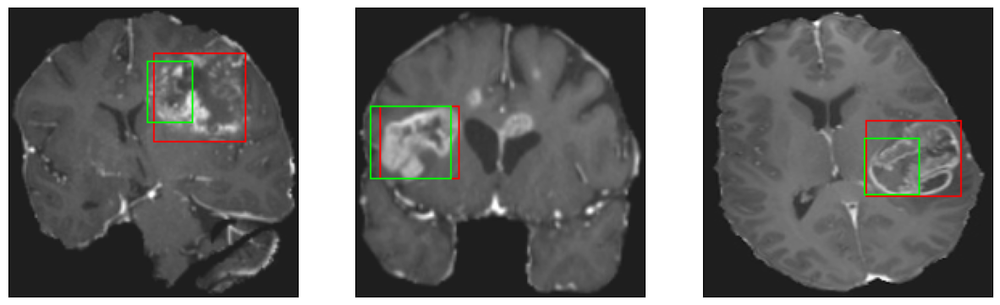

52/52 [==============================] - 10s 200ms/step - loss: 7.6003 - IoU: 0.4222 - val_loss: 8.1564 - val_IoU: 0.4306
Epoch 42/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


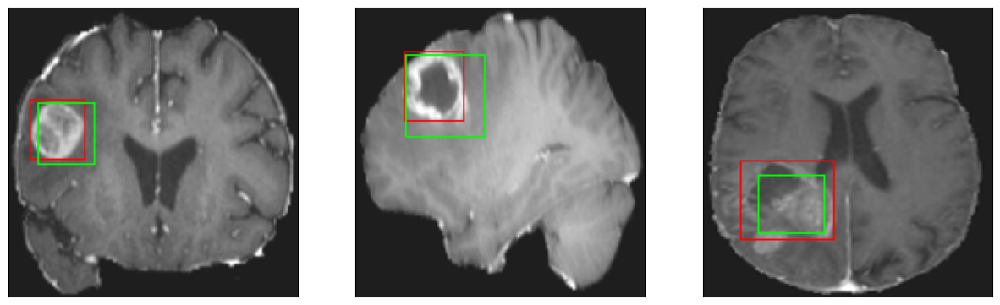

52/52 [==============================] - 11s 203ms/step - loss: 7.5150 - IoU: 0.4215 - val_loss: 7.9334 - val_IoU: 0.4541
Epoch 43/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


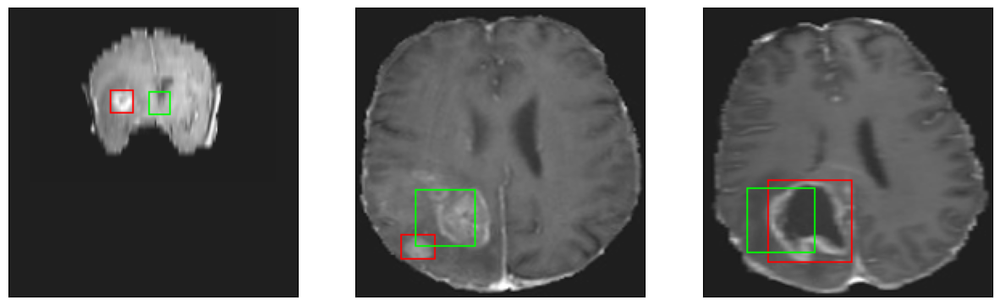

52/52 [==============================] - 11s 208ms/step - loss: 7.7234 - IoU: 0.4161 - val_loss: 7.9709 - val_IoU: 0.4272
Epoch 44/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


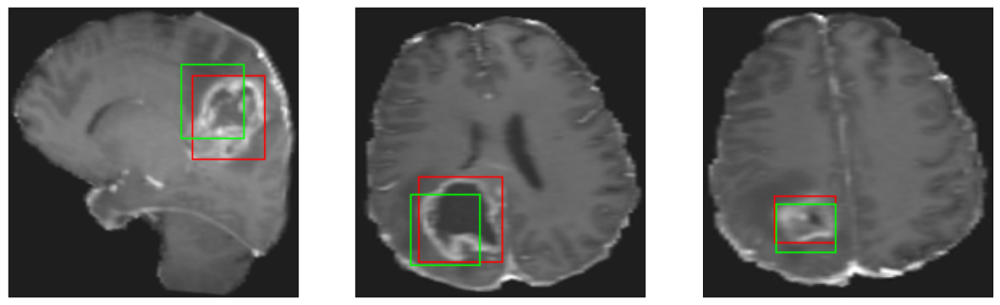

52/52 [==============================] - 11s 213ms/step - loss: 7.4518 - IoU: 0.4299 - val_loss: 8.3655 - val_IoU: 0.4183
Epoch 45/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


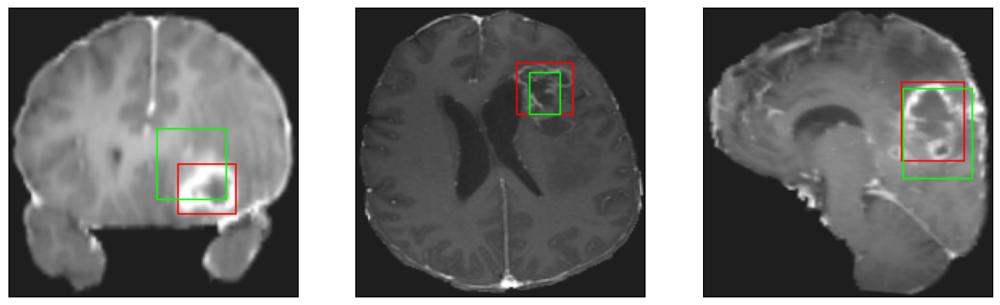

52/52 [==============================] - 11s 207ms/step - loss: 7.2563 - IoU: 0.4384 - val_loss: 8.6869 - val_IoU: 0.4115
Epoch 46/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


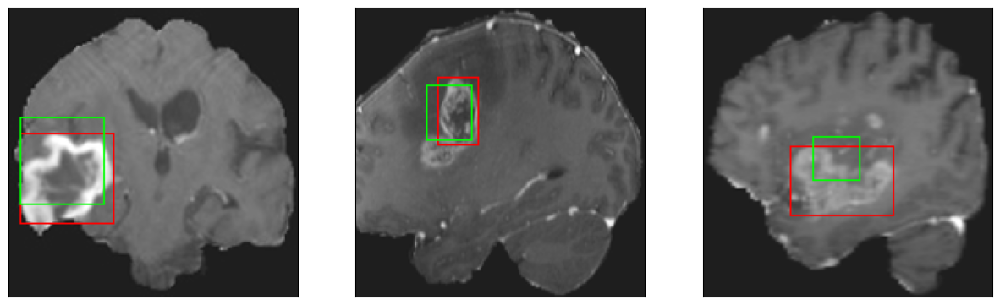

52/52 [==============================] - 11s 209ms/step - loss: 6.9626 - IoU: 0.4575 - val_loss: 8.8871 - val_IoU: 0.3749
Epoch 47/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


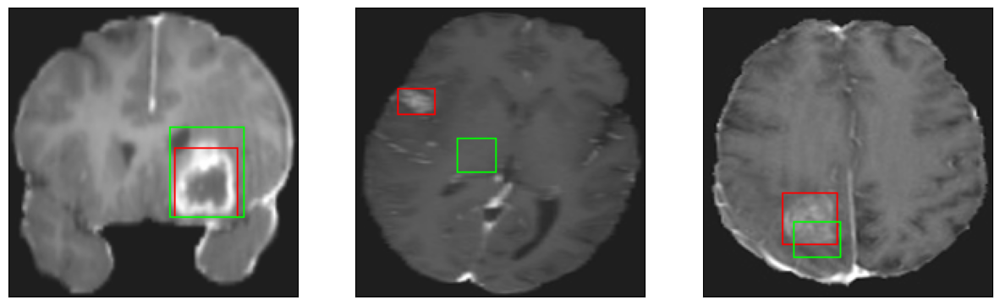

52/52 [==============================] - 11s 210ms/step - loss: 7.3534 - IoU: 0.4402 - val_loss: 8.0317 - val_IoU: 0.4420
Epoch 48/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


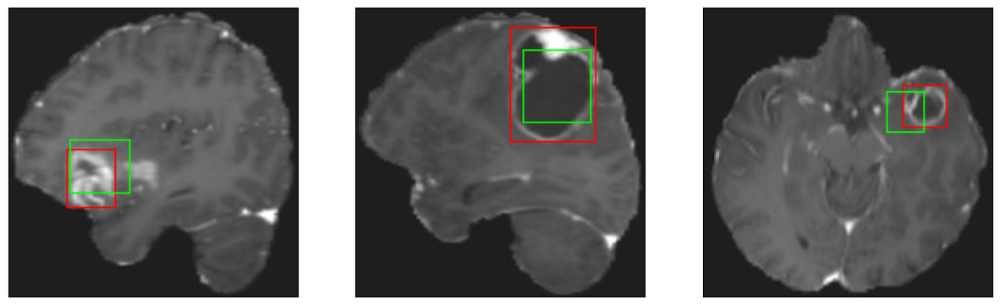

52/52 [==============================] - 10s 201ms/step - loss: 7.2952 - IoU: 0.4281 - val_loss: 8.2636 - val_IoU: 0.4234
Epoch 49/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


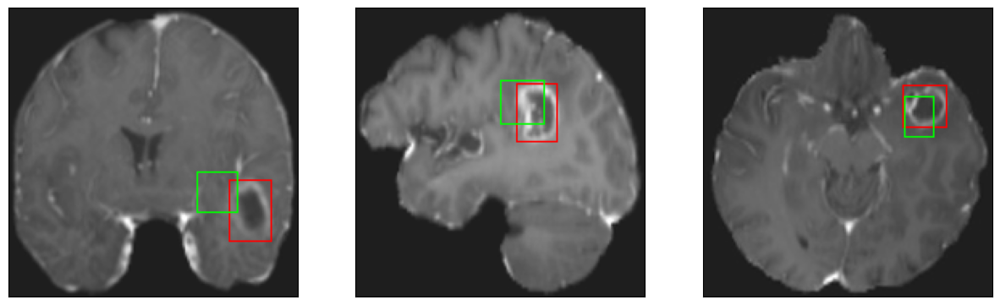

52/52 [==============================] - 11s 206ms/step - loss: 6.9189 - IoU: 0.4613 - val_loss: 9.0099 - val_IoU: 0.3711
Epoch 50/100
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


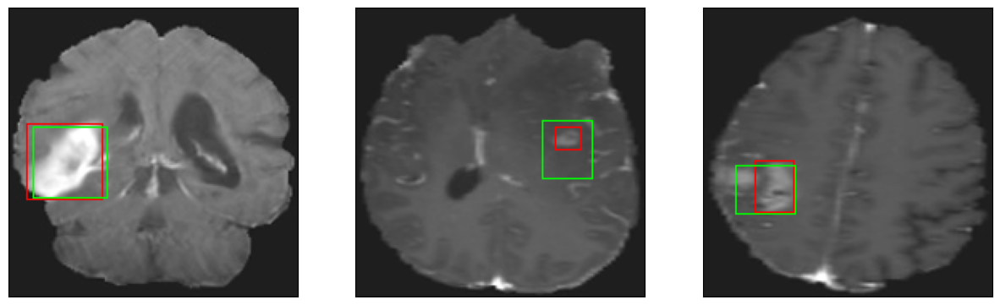

52/52 [==============================] - 11s 208ms/step - loss: 7.3063 - IoU: 0.4407 - val_loss: 8.2590 - val_IoU: 0.4659
Epoch 51/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


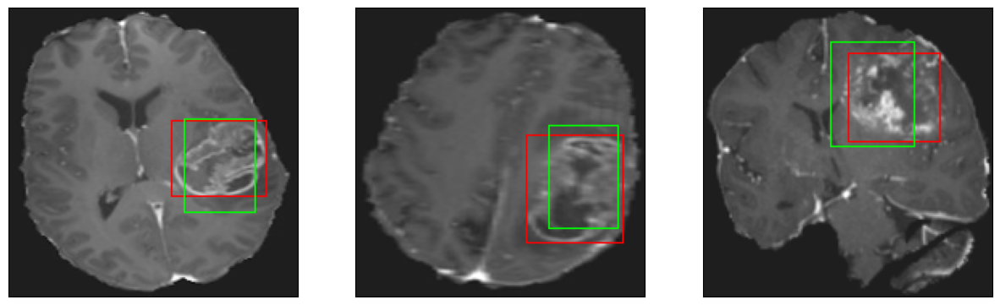

52/52 [==============================] - 11s 206ms/step - loss: 7.3474 - IoU: 0.4369 - val_loss: 9.2059 - val_IoU: 0.4544
Epoch 52/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


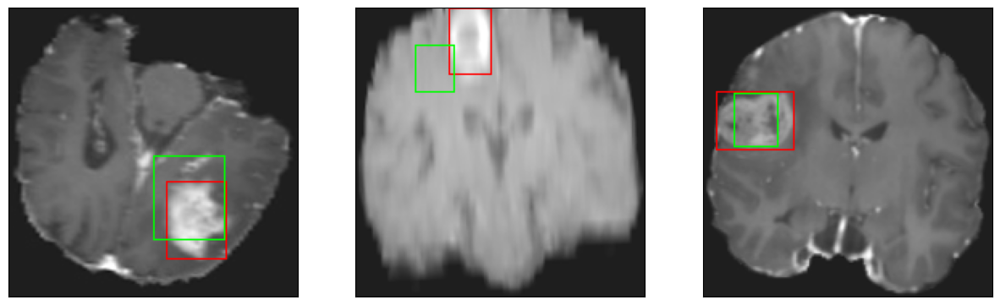

52/52 [==============================] - 11s 211ms/step - loss: 6.9370 - IoU: 0.4602 - val_loss: 7.9205 - val_IoU: 0.4786
Epoch 53/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


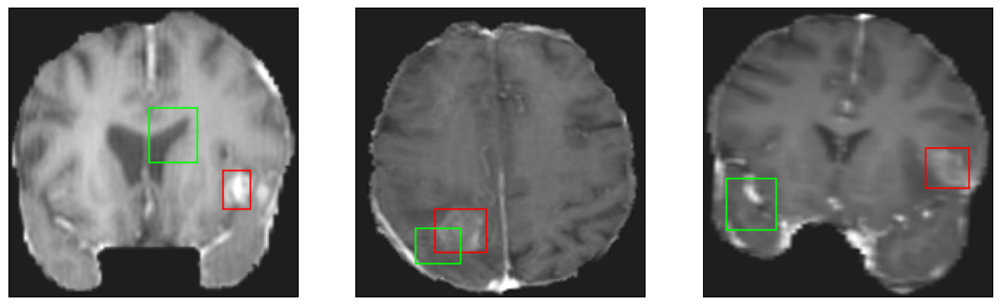

52/52 [==============================] - 10s 200ms/step - loss: 6.9678 - IoU: 0.4492 - val_loss: 8.2150 - val_IoU: 0.4415
Epoch 54/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 43ms/step
4


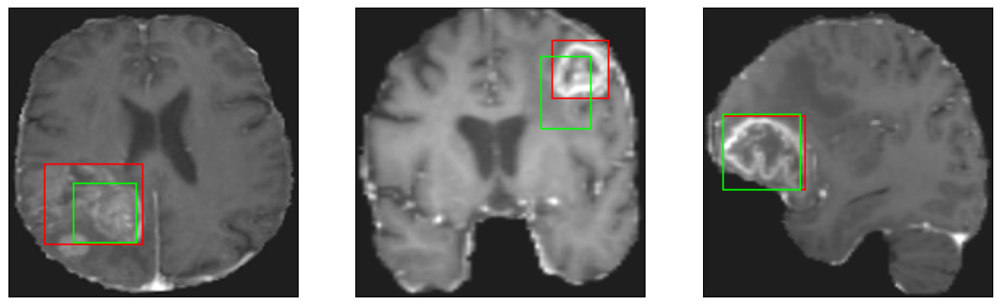

52/52 [==============================] - 11s 211ms/step - loss: 6.8429 - IoU: 0.4586 - val_loss: 7.6201 - val_IoU: 0.4983
Epoch 55/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


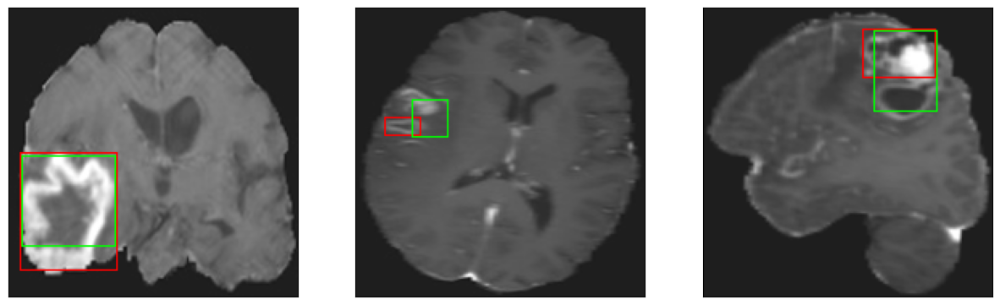

52/52 [==============================] - 11s 207ms/step - loss: 6.9396 - IoU: 0.4554 - val_loss: 8.6816 - val_IoU: 0.4297
Epoch 56/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


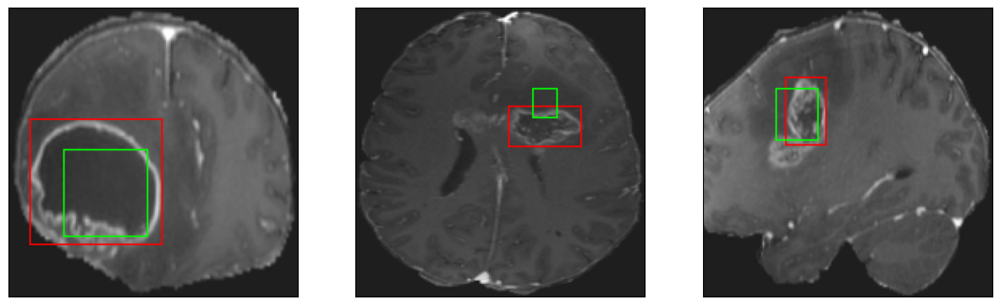

52/52 [==============================] - 11s 215ms/step - loss: 6.9122 - IoU: 0.4627 - val_loss: 8.3771 - val_IoU: 0.4134
Epoch 57/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


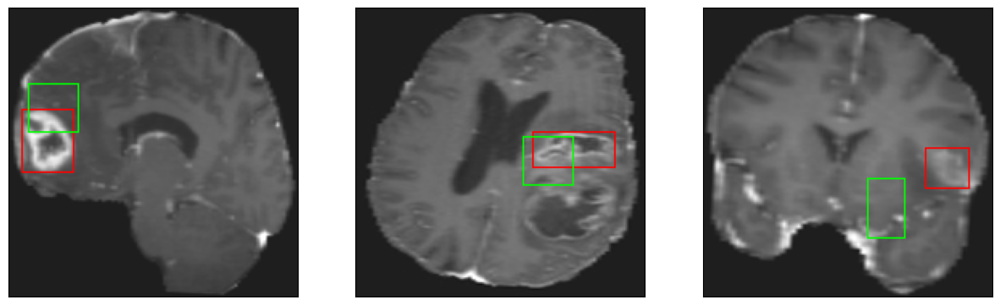

52/52 [==============================] - 11s 205ms/step - loss: 6.8988 - IoU: 0.4593 - val_loss: 9.4289 - val_IoU: 0.3597
Epoch 58/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


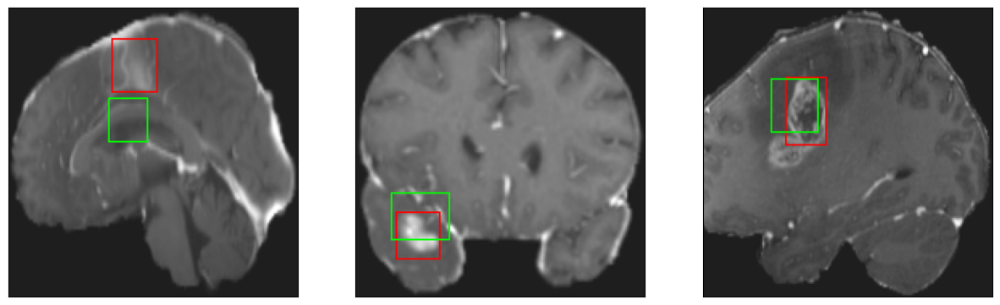

52/52 [==============================] - 11s 213ms/step - loss: 6.8139 - IoU: 0.4654 - val_loss: 8.2072 - val_IoU: 0.4323
Epoch 59/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


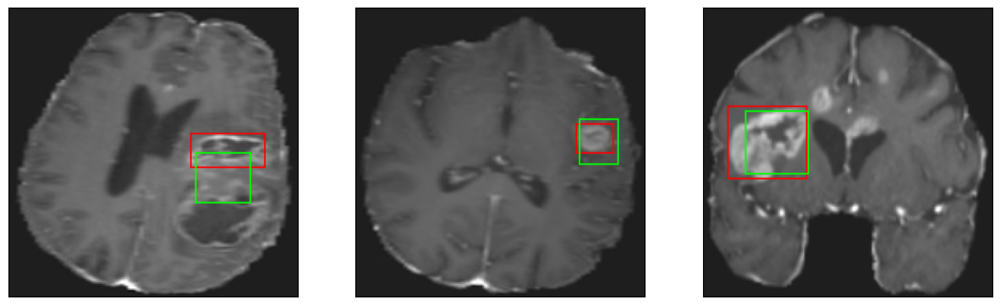

52/52 [==============================] - 11s 205ms/step - loss: 7.0280 - IoU: 0.4462 - val_loss: 7.8429 - val_IoU: 0.4718
Epoch 60/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


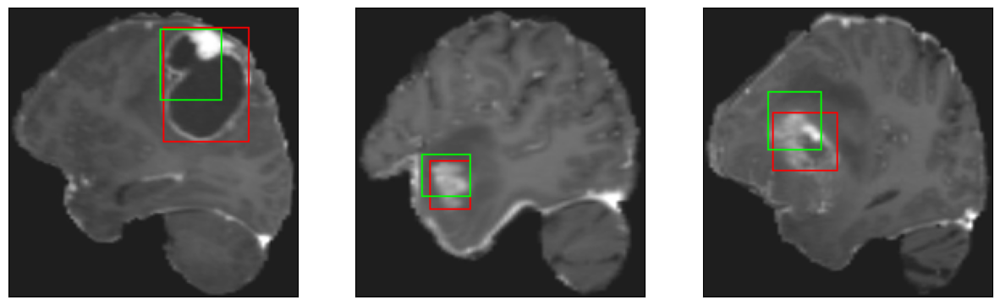

52/52 [==============================] - 11s 211ms/step - loss: 6.8745 - IoU: 0.4591 - val_loss: 8.1042 - val_IoU: 0.4328
Epoch 61/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


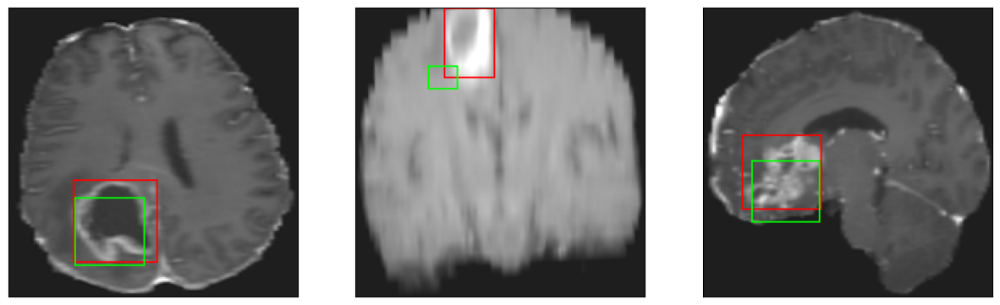

52/52 [==============================] - 11s 209ms/step - loss: 6.7381 - IoU: 0.4750 - val_loss: 8.0594 - val_IoU: 0.4188
Epoch 62/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


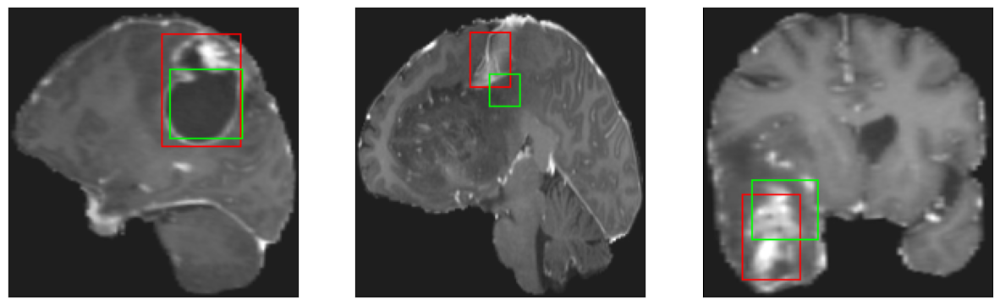

52/52 [==============================] - 11s 214ms/step - loss: 6.6509 - IoU: 0.4680 - val_loss: 10.0612 - val_IoU: 0.3428
Epoch 63/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


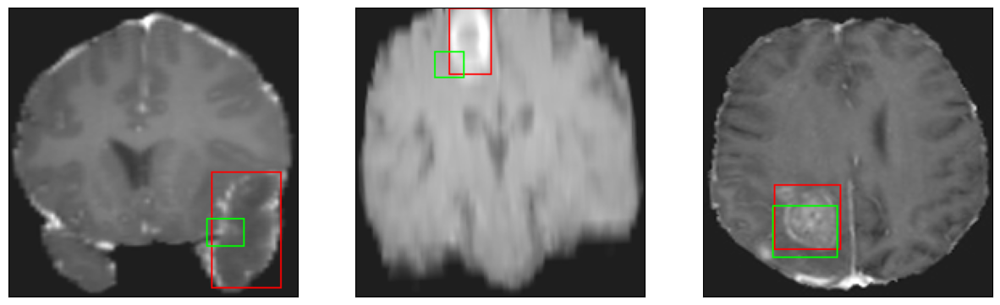

52/52 [==============================] - 11s 213ms/step - loss: 6.5407 - IoU: 0.4755 - val_loss: 7.8477 - val_IoU: 0.4389
Epoch 64/100
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4


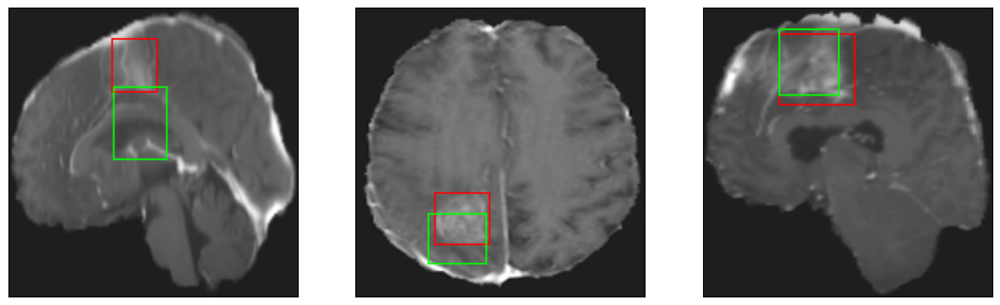

52/52 [==============================] - 11s 212ms/step - loss: 6.5310 - IoU: 0.4763 - val_loss: 9.3604 - val_IoU: 0.4433
Epoch 65/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


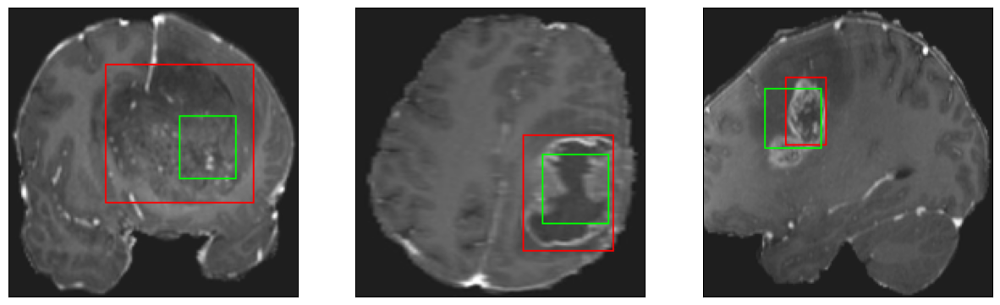

52/52 [==============================] - 11s 207ms/step - loss: 6.5516 - IoU: 0.4781 - val_loss: 7.3255 - val_IoU: 0.4883
Epoch 66/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


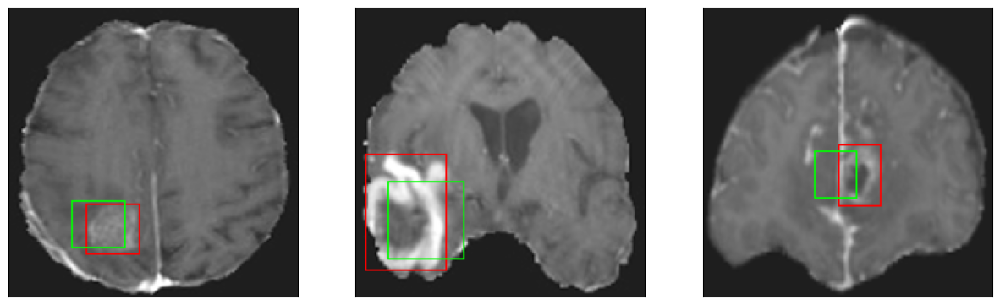

52/52 [==============================] - 11s 216ms/step - loss: 6.2504 - IoU: 0.4911 - val_loss: 7.7235 - val_IoU: 0.4425
Epoch 67/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


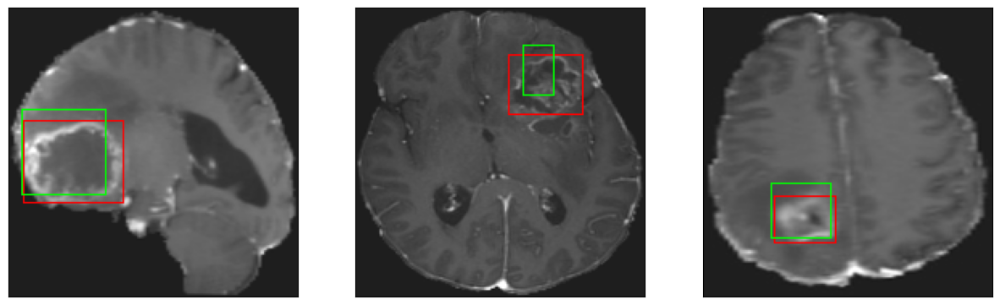

52/52 [==============================] - 11s 214ms/step - loss: 6.2260 - IoU: 0.4904 - val_loss: 8.3116 - val_IoU: 0.4372
Epoch 68/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


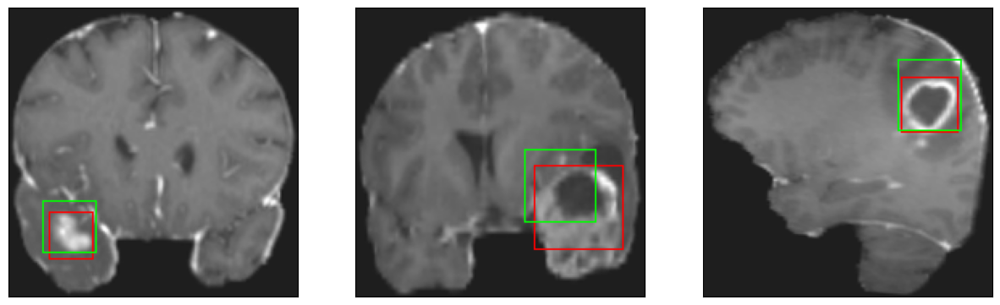

52/52 [==============================] - 11s 207ms/step - loss: 6.2790 - IoU: 0.4838 - val_loss: 8.2057 - val_IoU: 0.4294
Epoch 69/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


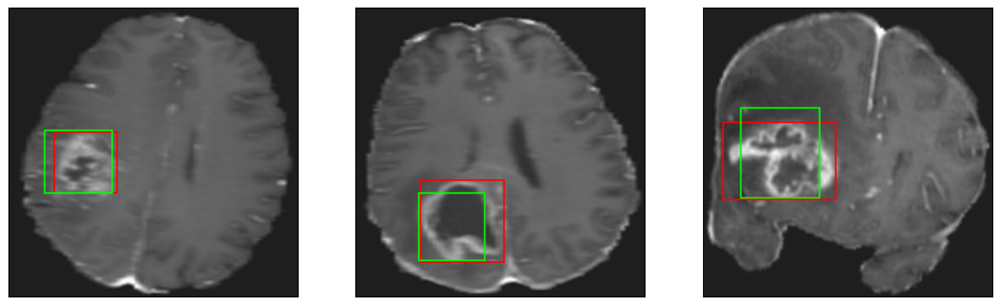

52/52 [==============================] - 11s 211ms/step - loss: 6.6054 - IoU: 0.4709 - val_loss: 8.5526 - val_IoU: 0.4287
Epoch 70/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


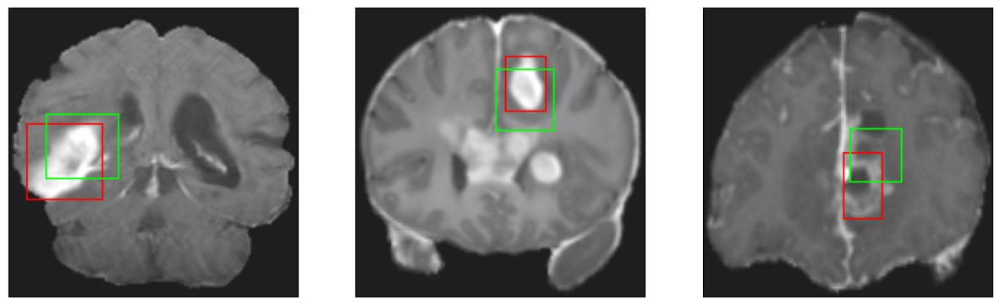

52/52 [==============================] - 11s 218ms/step - loss: 6.6155 - IoU: 0.4734 - val_loss: 7.4949 - val_IoU: 0.4894
Epoch 71/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


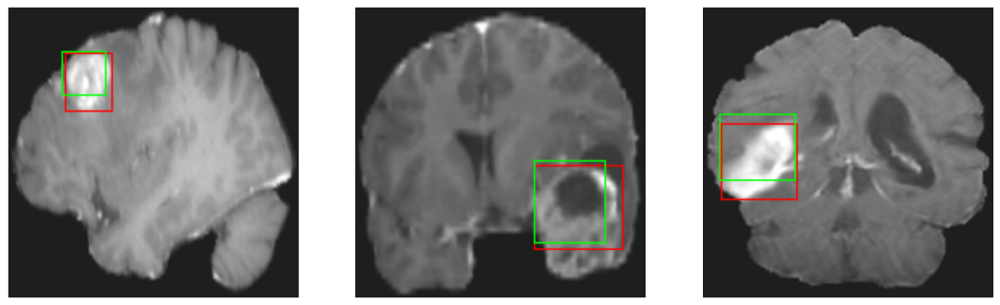

52/52 [==============================] - 11s 215ms/step - loss: 6.4556 - IoU: 0.4754 - val_loss: 8.2364 - val_IoU: 0.4133
Epoch 72/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


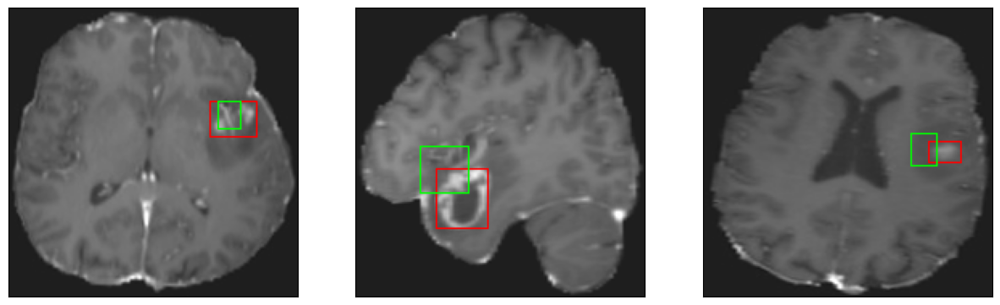

52/52 [==============================] - 11s 210ms/step - loss: 6.1513 - IoU: 0.5062 - val_loss: 9.4884 - val_IoU: 0.3382
Epoch 73/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


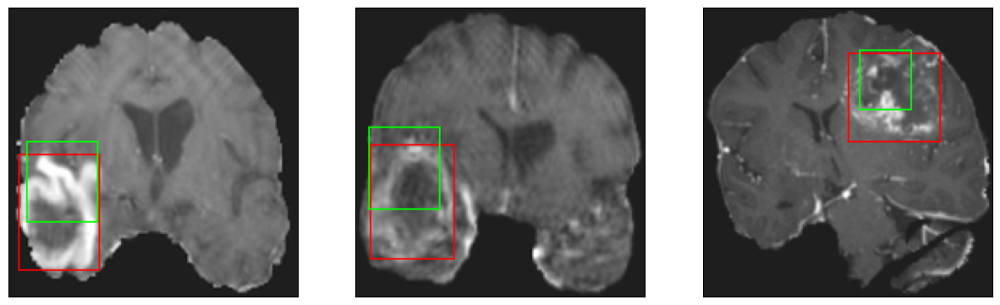

52/52 [==============================] - 11s 211ms/step - loss: 6.3013 - IoU: 0.4885 - val_loss: 8.1682 - val_IoU: 0.4383
Epoch 74/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


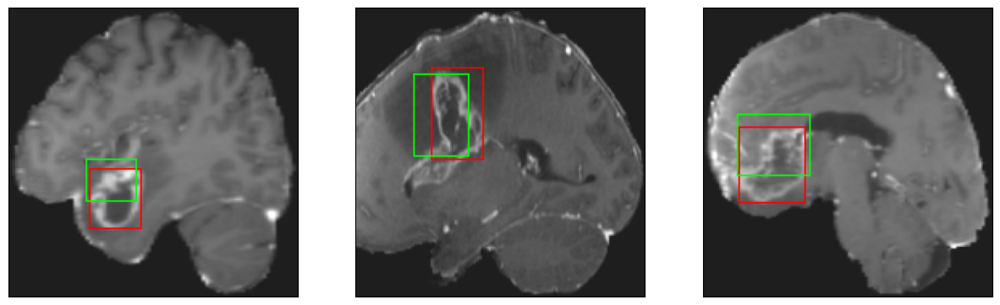

52/52 [==============================] - 11s 214ms/step - loss: 6.4329 - IoU: 0.4810 - val_loss: 8.4038 - val_IoU: 0.4125
Epoch 75/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


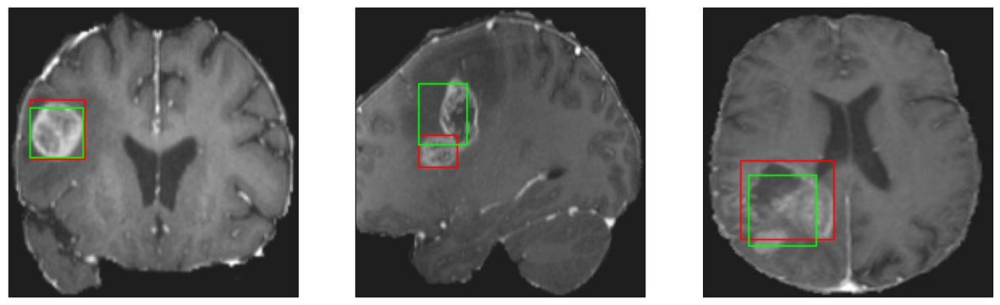

52/52 [==============================] - 11s 209ms/step - loss: 6.1736 - IoU: 0.4946 - val_loss: 7.1646 - val_IoU: 0.5011
Epoch 76/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


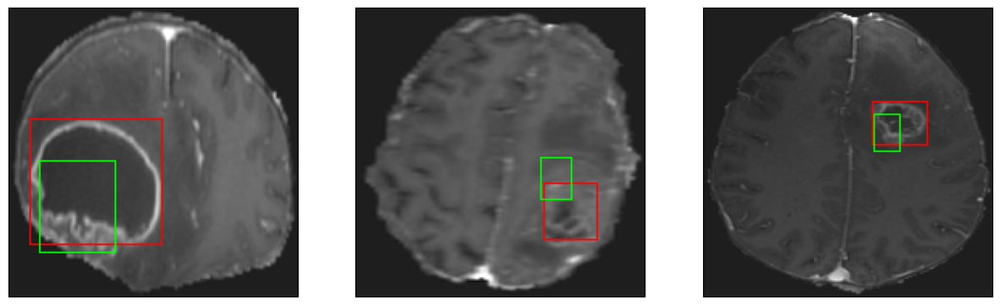

52/52 [==============================] - 11s 203ms/step - loss: 6.1884 - IoU: 0.4989 - val_loss: 7.9848 - val_IoU: 0.4383
Epoch 77/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


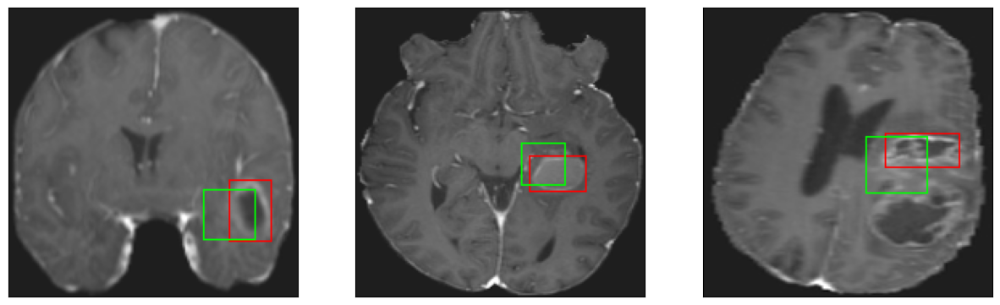

52/52 [==============================] - 10s 200ms/step - loss: 6.1892 - IoU: 0.4955 - val_loss: 7.0058 - val_IoU: 0.4945
Epoch 78/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


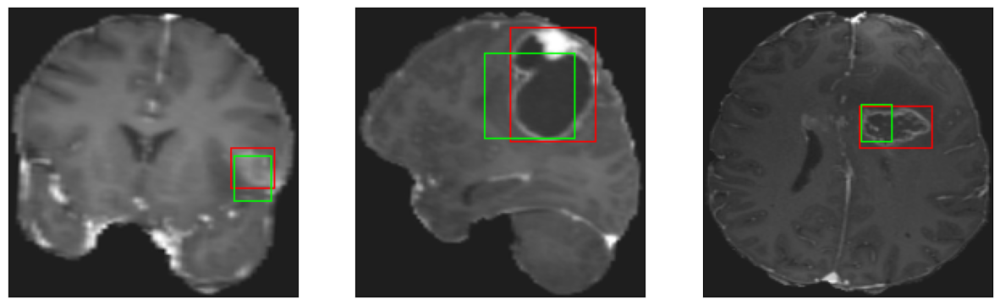

52/52 [==============================] - 11s 215ms/step - loss: 6.1950 - IoU: 0.5001 - val_loss: 8.2705 - val_IoU: 0.4101
Epoch 79/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


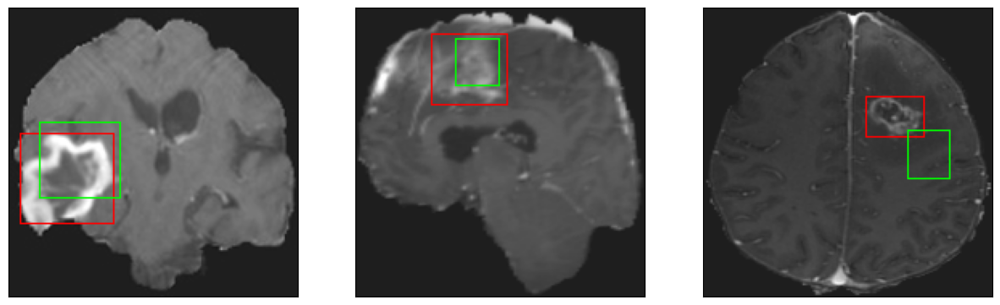

52/52 [==============================] - 11s 210ms/step - loss: 5.8083 - IoU: 0.5148 - val_loss: 7.8141 - val_IoU: 0.4458
Epoch 80/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


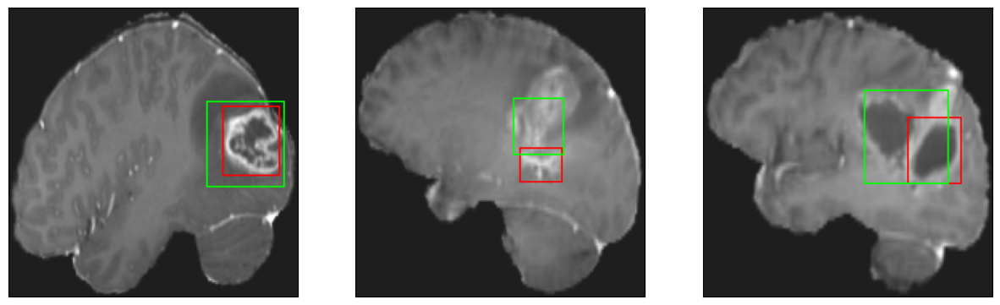

52/52 [==============================] - 11s 219ms/step - loss: 6.3312 - IoU: 0.4836 - val_loss: 7.0177 - val_IoU: 0.5197
Epoch 81/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


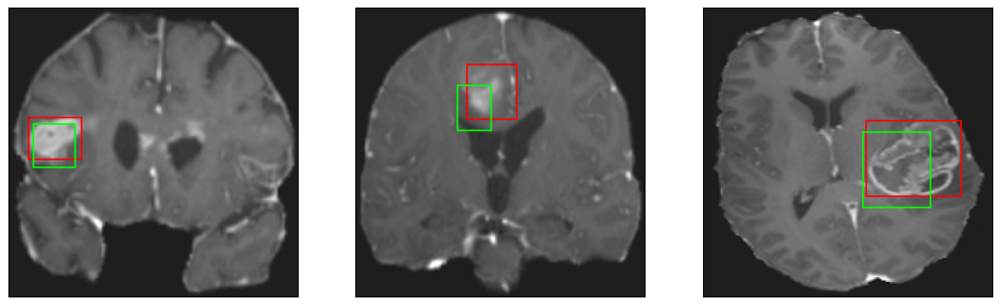

52/52 [==============================] - 11s 215ms/step - loss: 6.2819 - IoU: 0.4882 - val_loss: 7.7134 - val_IoU: 0.4761
Epoch 82/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


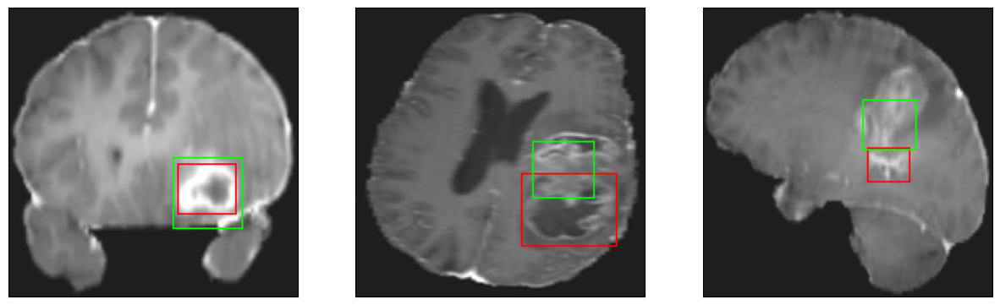

52/52 [==============================] - 11s 203ms/step - loss: 6.0731 - IoU: 0.5050 - val_loss: 7.1364 - val_IoU: 0.4864
Epoch 83/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


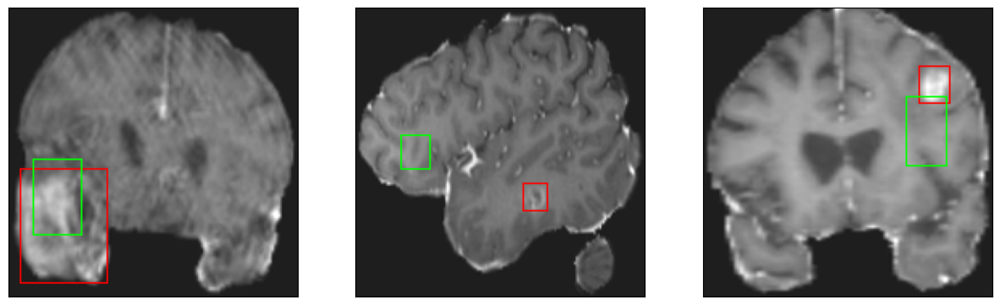

52/52 [==============================] - 11s 211ms/step - loss: 6.0430 - IoU: 0.5020 - val_loss: 8.4917 - val_IoU: 0.4079
Epoch 84/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 42ms/step
4


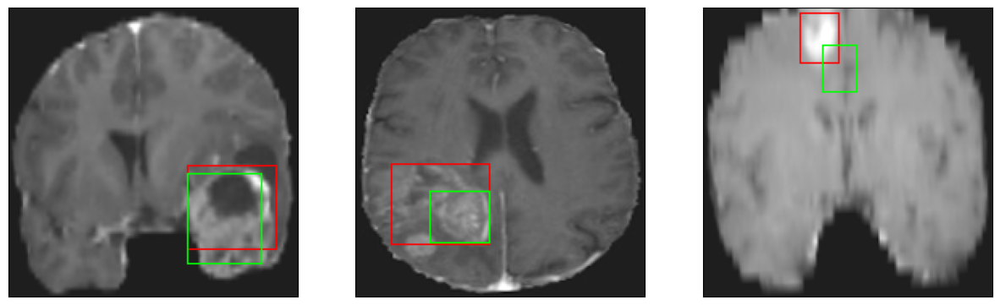

52/52 [==============================] - 11s 215ms/step - loss: 5.6891 - IoU: 0.5283 - val_loss: 7.7151 - val_IoU: 0.5075
Epoch 85/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


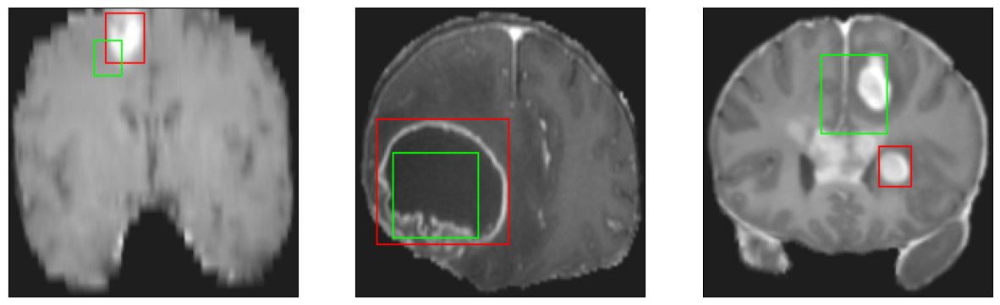

52/52 [==============================] - 11s 214ms/step - loss: 6.0878 - IoU: 0.5028 - val_loss: 8.2428 - val_IoU: 0.4182
Epoch 86/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


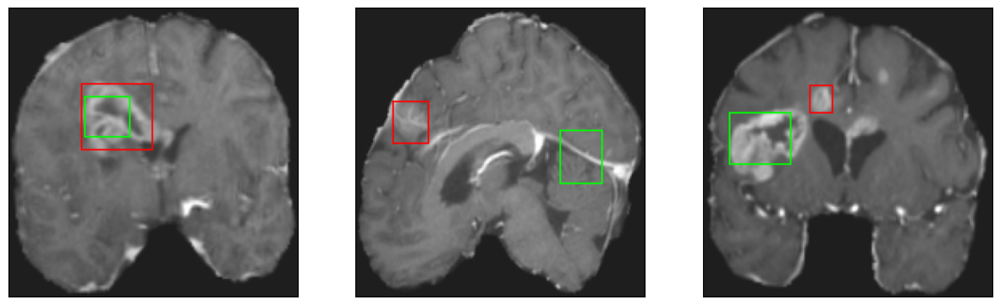

52/52 [==============================] - 11s 214ms/step - loss: 6.0134 - IoU: 0.5044 - val_loss: 8.5383 - val_IoU: 0.4196
Epoch 87/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


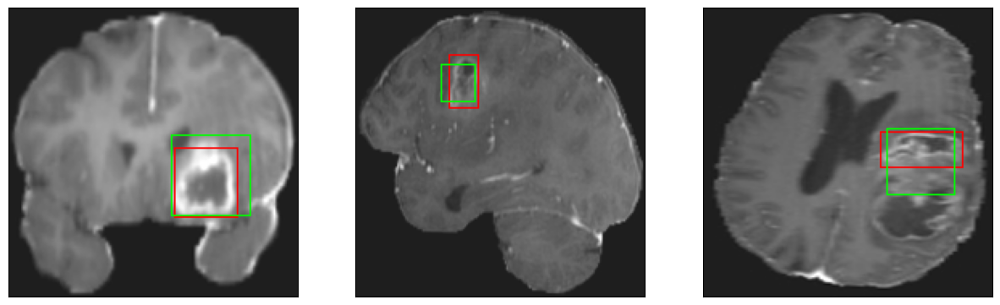

52/52 [==============================] - 11s 216ms/step - loss: 5.9970 - IoU: 0.5091 - val_loss: 7.4546 - val_IoU: 0.5014
Epoch 88/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


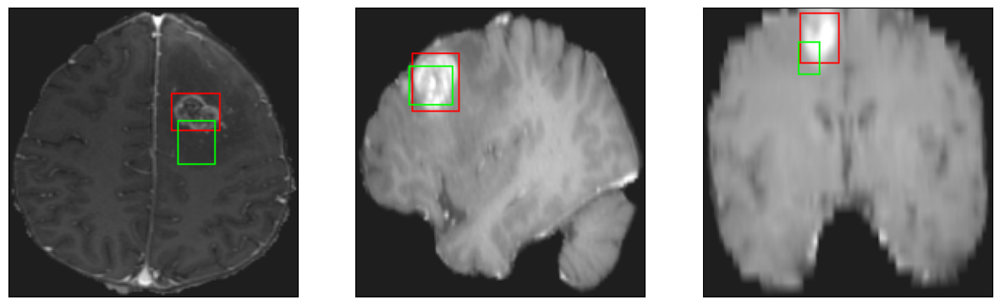

52/52 [==============================] - 11s 215ms/step - loss: 5.9395 - IoU: 0.5181 - val_loss: 7.0767 - val_IoU: 0.5129
Epoch 89/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4


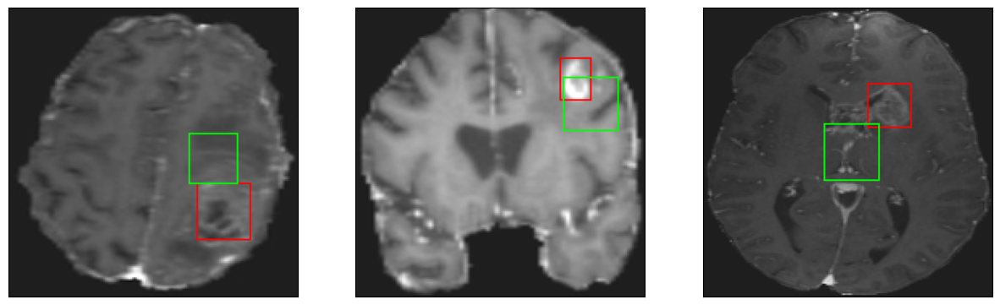

52/52 [==============================] - 11s 209ms/step - loss: 5.9704 - IoU: 0.5082 - val_loss: 8.0255 - val_IoU: 0.4271
Epoch 90/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


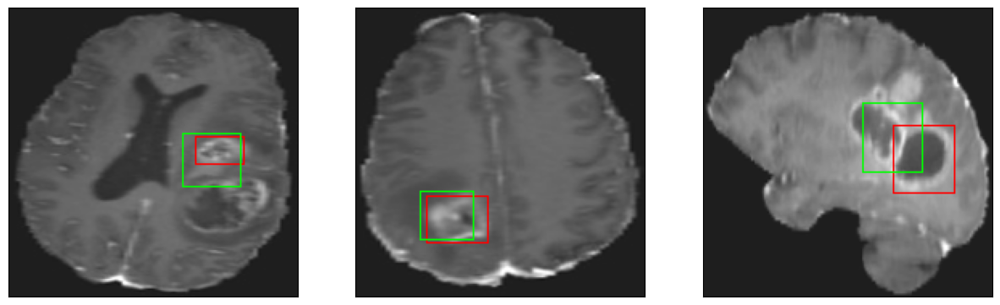

52/52 [==============================] - 11s 208ms/step - loss: 5.8603 - IoU: 0.5102 - val_loss: 8.1506 - val_IoU: 0.4244
Epoch 91/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


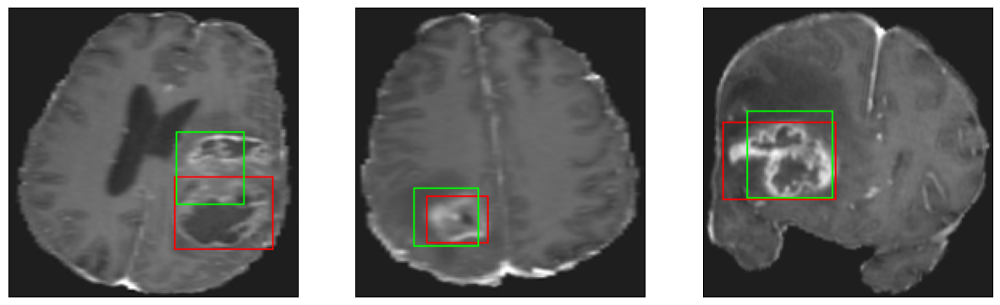

52/52 [==============================] - 11s 216ms/step - loss: 5.6998 - IoU: 0.5216 - val_loss: 7.1092 - val_IoU: 0.5146
Epoch 92/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


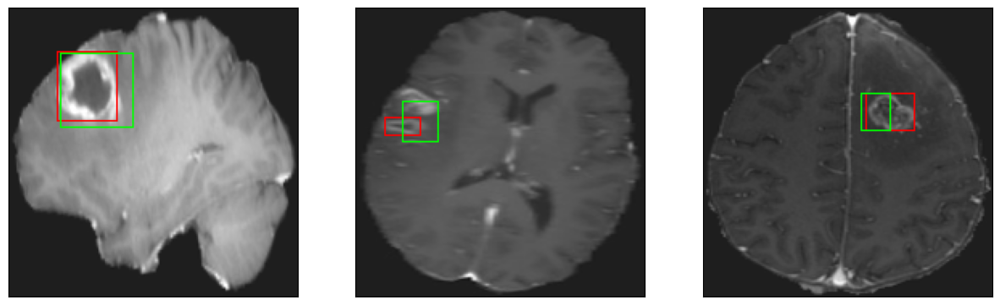

52/52 [==============================] - 11s 207ms/step - loss: 5.8912 - IoU: 0.5135 - val_loss: 7.3034 - val_IoU: 0.4501
Epoch 93/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


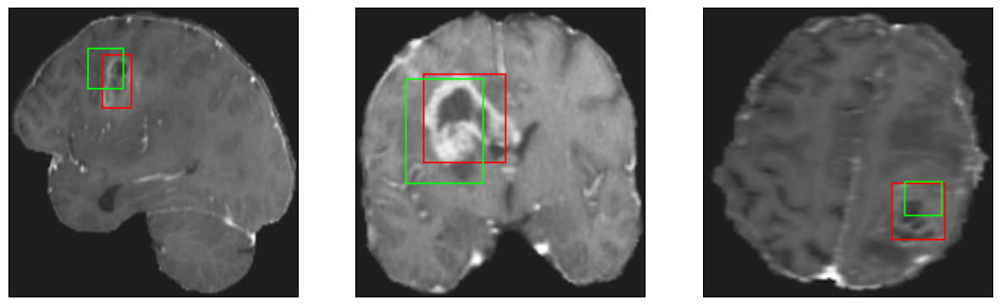

52/52 [==============================] - 11s 208ms/step - loss: 6.0347 - IoU: 0.4985 - val_loss: 7.7823 - val_IoU: 0.4392
Epoch 94/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


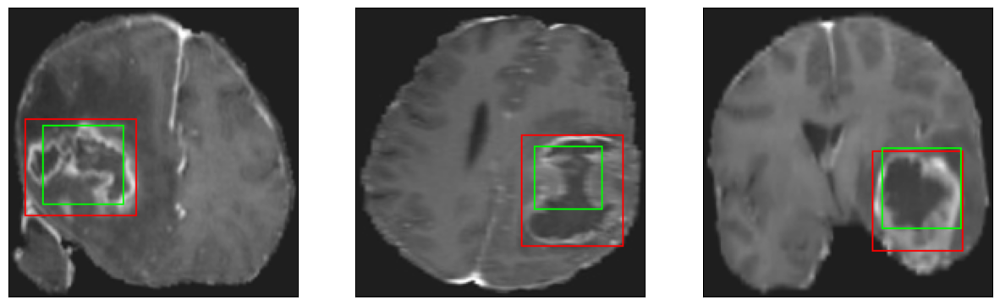

52/52 [==============================] - 11s 208ms/step - loss: 5.7889 - IoU: 0.5239 - val_loss: 8.2369 - val_IoU: 0.4502
Epoch 95/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


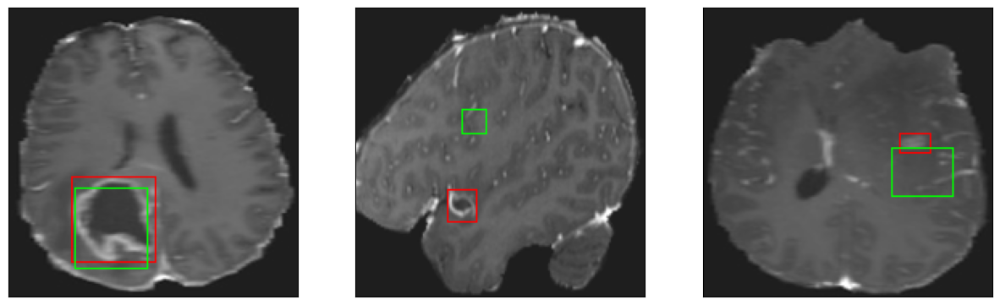

52/52 [==============================] - 11s 215ms/step - loss: 5.8344 - IoU: 0.5171 - val_loss: 8.0630 - val_IoU: 0.4334
Epoch 96/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


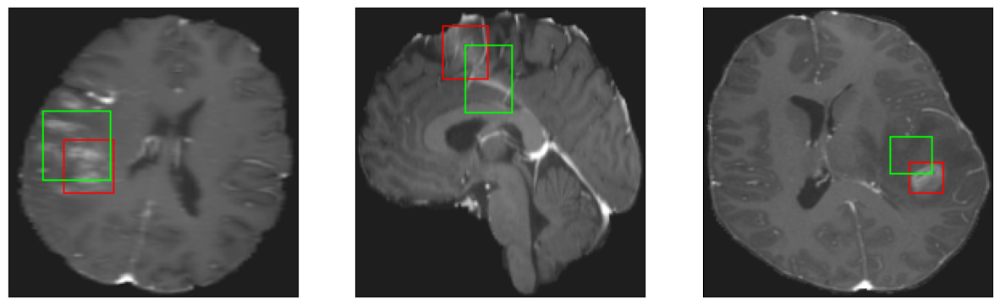

52/52 [==============================] - 11s 206ms/step - loss: 6.0630 - IoU: 0.5074 - val_loss: 7.6156 - val_IoU: 0.4684
Epoch 97/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


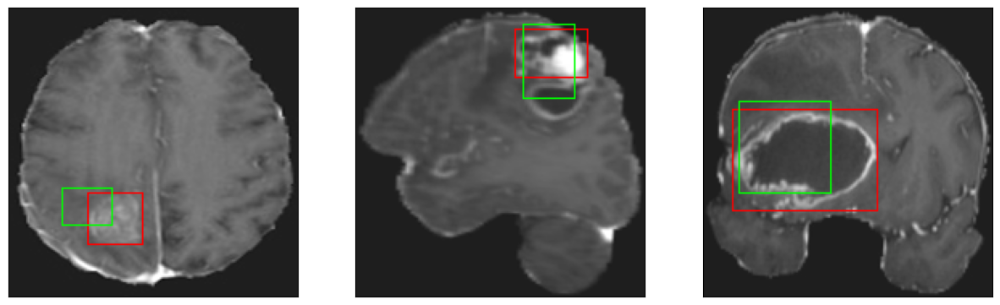

52/52 [==============================] - 11s 214ms/step - loss: 5.6571 - IoU: 0.5287 - val_loss: 8.7601 - val_IoU: 0.3881
Epoch 98/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


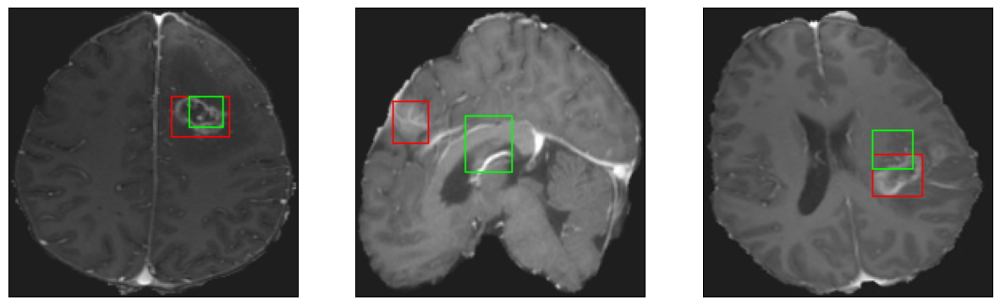

52/52 [==============================] - 11s 214ms/step - loss: 5.8465 - IoU: 0.5153 - val_loss: 9.6805 - val_IoU: 0.3636
Epoch 99/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


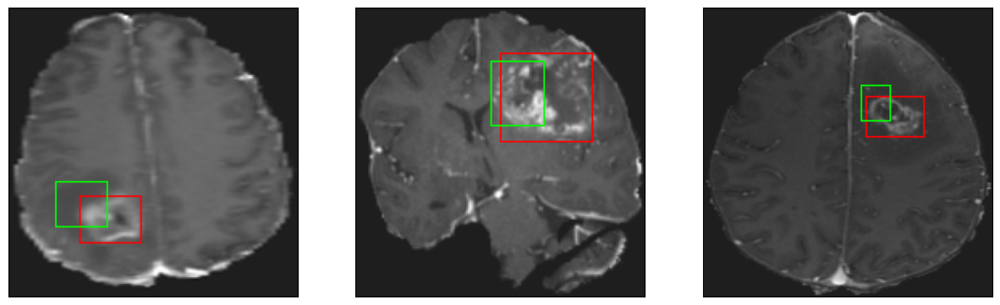

52/52 [==============================] - 11s 215ms/step - loss: 5.9483 - IoU: 0.4993 - val_loss: 9.3500 - val_IoU: 0.3612
Epoch 100/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


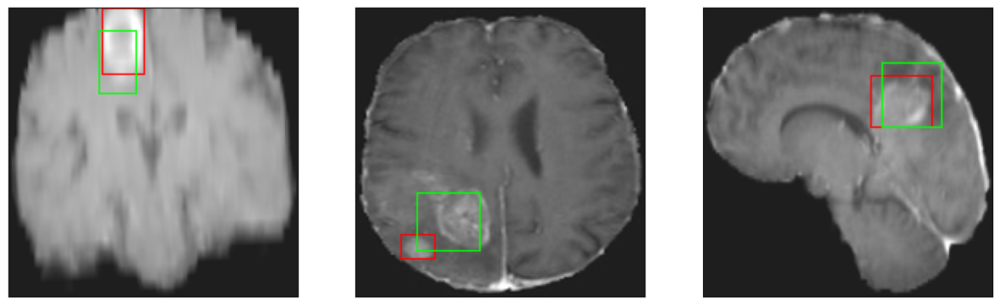

52/52 [==============================] - 12s 225ms/step - loss: 5.5091 - IoU: 0.5366 - val_loss: 7.3745 - val_IoU: 0.4951


In [25]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

<Axes: >

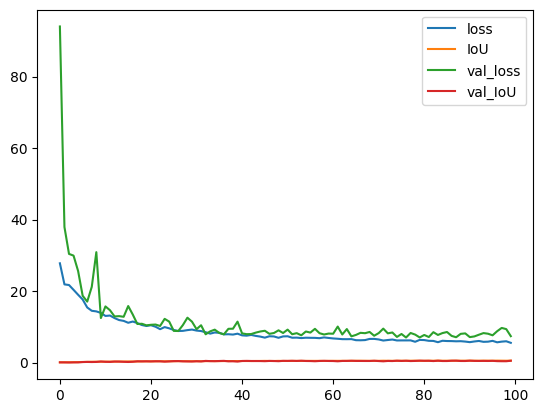

In [26]:
pd.DataFrame(model.history.history).plot()

In [27]:
model.evaluate(test_dataset)

8/8 [==============================] - 0s 52ms/step - loss: 8.3286 - IoU: 0.4545


[8.328625679016113, 0.4545381963253021]